In [15]:
from google.colab import drive

drive.mount("/content/gdrive")

Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).


In [16]:
ls ./gdrive/MyDrive/STAI/maps

train/  val/


In [17]:
import os
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt

In [18]:
train_paths = []
val_paths = []

for i in os.listdir("./gdrive/MyDrive/STAI/maps/train"):
    train_paths.append(f"./gdrive/MyDrive/STAI/maps/train/{i}")
for i in os.listdir("./gdrive/MyDrive/STAI/maps/val"):
    val_paths.append(f"./gdrive/MyDrive/STAI/maps/val/{i}")

In [19]:
len(train_paths), len(val_paths)

(1101, 1098)

In [20]:
import torch
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms

In [58]:
class MapsDataset(Dataset):
    def __init__(self, paths):
        self.transforms = transforms.Compose([
            transforms.Resize((256, 512), Image.BICUBIC),
        ])
        self.paths = paths
    
    def __getitem__(self, idx):
        img = Image.open(self.paths[idx]).convert("RGB")
        img = self.transforms(img)
        img = np.array(img, dtype="float32")
        img = (img - 127.5) / 127.5
        img = transforms.ToTensor()(img)
        src, tar = img[:, :, :256], img[:, :, 256:]
        return {"src": src, "tar": tar}
    
    def __len__(self):
        return len(self.paths)

In [22]:
img = Image.open("./gdrive/MyDrive/STAI/maps/train/1.jpg").convert("RGB")
img = transforms.Resize((256, 512), Image.BICUBIC)(img)
img = np.array(img)
img = (img - 127.5) / 127.5
img = transforms.ToTensor()(img)
src, tar = img[:, :, :256], img[:, :, 256:]
print(src.shape, tar.shape)

torch.Size([3, 256, 256]) torch.Size([3, 256, 256])


/usr/local/lib/python3.9/dist-packages/torchvision/transforms/transforms.py:329: UserWarning: Argument 'interpolation' of type int is deprecated since 0.13 and will be removed in 0.15. Please use InterpolationMode enum.
  warnings.warn(


In [59]:
train_ds = MapsDataset(train_paths)
val_ds = MapsDataset(val_paths)

/usr/local/lib/python3.9/dist-packages/torchvision/transforms/transforms.py:329: UserWarning: Argument 'interpolation' of type int is deprecated since 0.13 and will be removed in 0.15. Please use InterpolationMode enum.
  warnings.warn(


In [60]:
train_ds[0]["src"].shape

torch.Size([3, 256, 256])

In [61]:
train_dl = DataLoader(train_ds, batch_size=1)
val_dl = DataLoader(val_ds, batch_size=1)

In [62]:
data = next(iter(train_dl))

In [63]:
torch.permute(data["src"].squeeze(), (1, 2, 0)).shape

torch.Size([256, 256, 3])

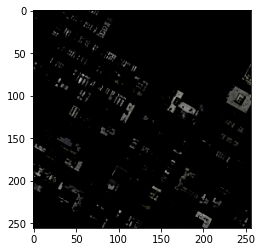

In [64]:
plt.imshow(torch.permute(data["src"].squeeze(), (1, 2, 0)))

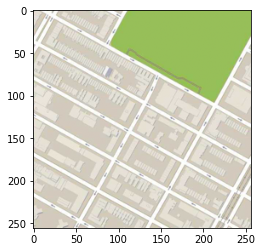

In [29]:
plt.imshow(torch.permute(data["tar"].squeeze(), (1, 2, 0)))

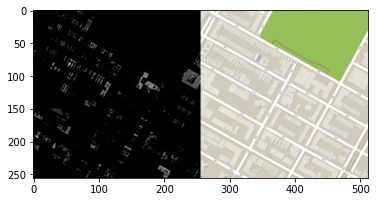

In [30]:
plt.imshow(torch.permute(torch.cat([data["src"], data["tar"]], 3).squeeze(), (1, 2, 0)))

In [31]:
from torch import nn, optim

In [32]:
class Discriminator(nn.Module):
    def __init__(self):
        super().__init__()

        self.conv1 = nn.Conv2d(6, 64, 4, stride=2)
        self.conv2 = nn.Conv2d(64, 128, 4, stride=2)
        self.conv3 = nn.Conv2d(128, 256, 4, stride=2)
        self.conv4 = nn.Conv2d(256, 512, 4, stride=2)
        self.conv5 = nn.Conv2d(512, 512, 4, stride=1)
        self.conv6 = nn.Conv2d(512, 1, 4, stride=1)

        self.batch_norm1 = nn.BatchNorm2d(128)
        self.batch_norm2 = nn.BatchNorm2d(256)
        self.batch_norm3 = nn.BatchNorm2d(512)
        self.batch_norm4 = nn.BatchNorm2d(512)

        self.leaky_relu = nn.LeakyReLU(0.2)
        self.sigmoid = nn.Sigmoid()
    
    def forward(self, X):
        X = self.leaky_relu(self.conv1(X))
        X = self.leaky_relu(self.batch_norm1(self.conv2(X)))
        X = self.leaky_relu(self.batch_norm2(self.conv3(X)))
        X = self.leaky_relu(self.batch_norm3(self.conv4(X)))
        X = self.leaky_relu(self.batch_norm4(self.conv5(X)))
        X = self.sigmoid(self.conv6(X))
        return X

In [33]:
class Generator(nn.Module):
    def __init__(self):
        super().__init__()

        self.d_conv1 = nn.Conv2d(3, 64, 4, stride=2, padding=1)
        self.d_conv2 = nn.Conv2d(64, 128, 4, stride=2, padding=1)
        self.d_conv3 = nn.Conv2d(128, 256, 4, stride=2, padding=1)
        self.d_conv4 = nn.Conv2d(256, 512, 4, stride=2, padding=1)
        self.d_conv5 = nn.Conv2d(512, 512, 4, stride=2, padding=1)
        self.d_conv6 = nn.Conv2d(512, 512, 4, stride=2, padding=1)
        self.d_conv7 = nn.Conv2d(512, 512, 4, stride=2, padding=1)

        self.b_conv = nn.Conv2d(512, 512, 4, stride=1, padding=1)

        self.u_conv1 = nn.ConvTranspose2d(512, 512, 4, stride=1, padding=1)
        self.u_conv2 = nn.ConvTranspose2d(512 * 2, 512, 4, stride=2, padding=1)
        self.u_conv3 = nn.ConvTranspose2d(512 * 2, 512, 4, stride=2, padding=1)
        self.u_conv4 = nn.ConvTranspose2d(512 * 2, 512, 4, stride=2, padding=1)
        self.u_conv5 = nn.ConvTranspose2d(512 * 2, 256, 4, stride=2, padding=1)
        self.u_conv6 = nn.ConvTranspose2d(256 * 2, 128, 4, stride=2, padding=1)
        self.u_conv7 = nn.ConvTranspose2d(128 * 2, 64, 4, stride=2, padding=1)

        self.g_conv = nn.ConvTranspose2d(64 * 2, 3, 4, stride=2, padding=1)

        self.d_batch_norm1 = nn.BatchNorm2d(128)
        self.d_batch_norm2 = nn.BatchNorm2d(256)
        self.d_batch_norm3 = nn.BatchNorm2d(512)
        self.d_batch_norm4 = nn.BatchNorm2d(512)
        self.d_batch_norm5 = nn.BatchNorm2d(512)
        self.d_batch_norm6 = nn.BatchNorm2d(512)

        self.u_batch_norm1 = nn.BatchNorm2d(512)
        self.u_batch_norm2 = nn.BatchNorm2d(512)
        self.u_batch_norm3 = nn.BatchNorm2d(512)
        self.u_batch_norm4 = nn.BatchNorm2d(512)
        self.u_batch_norm5 = nn.BatchNorm2d(256)
        self.u_batch_norm6 = nn.BatchNorm2d(128)
        self.u_batch_norm7 = nn.BatchNorm2d(64)

        self.dropout_1 = nn.Dropout(0.5)
        self.dropout_2 = nn.Dropout(0.5)
        self.dropout_3 = nn.Dropout(0.5)

        self.leaky_relu = nn.LeakyReLU(0.2)
        self.relu = nn.ReLU()
        self.tanh = nn.Tanh()
    
    def forward(self, X):
        d1 = self.leaky_relu(self.d_conv1(X))
        d2 = self.leaky_relu(self.d_batch_norm1(self.d_conv2(d1)))
        d3 = self.leaky_relu(self.d_batch_norm2(self.d_conv3(d2)))
        d4 = self.leaky_relu(self.d_batch_norm3(self.d_conv4(d3)))
        d5 = self.leaky_relu(self.d_batch_norm4(self.d_conv5(d4)))
        d6 = self.leaky_relu(self.d_batch_norm5(self.d_conv6(d5)))
        d7 = self.leaky_relu(self.d_batch_norm6(self.d_conv7(d6)))

        b = self.relu(self.b_conv(d7))

        u1 = self.relu(torch.cat([self.dropout_1(self.u_batch_norm1(self.u_conv1(b))), d7], 1))
        u2 = self.relu(torch.cat([self.dropout_2(self.u_batch_norm2(self.u_conv2(u1))), d6], 1))
        u3 = self.relu(torch.cat([self.dropout_3(self.u_batch_norm3(self.u_conv3(u2))), d5], 1))
        u4 = self.relu(torch.cat([self.u_batch_norm4(self.u_conv4(u3)), d4], 1))
        u5 = self.relu(torch.cat([self.u_batch_norm5(self.u_conv5(u4)), d3], 1))
        u6 = self.relu(torch.cat([self.u_batch_norm6(self.u_conv6(u5)), d2], 1))
        u7 = self.relu(torch.cat([self.u_batch_norm7(self.u_conv7(u6)), d1], 1))

        g = self.tanh(self.g_conv(u7))
        return g

In [102]:
class GAN(nn.Module):
    def __init__(self):
        super().__init__()
        self.device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
        self.generator = Generator().to(self.device)
        self.discriminator = Discriminator().to(self.device)
        self.GANcriterion = nn.BCEWithLogitsLoss().to(self.device)
        self.L1criterion = nn.L1Loss().to(self.device)
        self.opt_generator = optim.Adam(self.generator.parameters(), lr=0.001)
        self.opt_discriminator = optim.Adam(self.discriminator.parameters(), lr=0.001)
    
    def setup_input(self, data):
        self.src = data["src"].to(self.device)
        self.tar = data["tar"].to(self.device)
    
    def forward(self):
        self.generated_tar = self.generator(self.src)
    
    def set_requires_grad(self, model, requires_grad=True):
        for param in model.parameters():
            param.requires_grad = requires_grad
    
    def backward_discriminator(self):
        generated_map = torch.cat([self.src, self.generated_tar], 1)
        generated_preds = self.discriminator(generated_map.detach())
        real_map = torch.cat([self.src, self.tar], 1)
        real_preds = self.discriminator(real_map)
        loss_discriminator_generated = self.GANcriterion(generated_preds.to(self.device), torch.zeros(generated_preds.shape).to(self.device))
        loss_discriminator_real = self.GANcriterion(real_preds.to(self.device), torch.ones(real_preds.shape).to(self.device))
        loss_discriminator = (loss_discriminator_generated + loss_discriminator_real) * 0.5
        loss_discriminator.backward()
    
    def backward_generator(self):
        generated_map = torch.cat([self.src, self.generated_tar], 1)
        generated_preds = self.discriminator(generated_map.to(self.device))
        loss_generator_gan = self.GANcriterion(generated_preds.to(self.device), torch.ones(generated_preds.shape).to(self.device))
        loss_generator_l1 = self.L1criterion(self.generated_tar.to(self.device), self.tar.to(self.device)) * 100.0
        loss_generator = loss_generator_gan + loss_generator_l1
        loss_generator.backward()

    def optimize(self):
        self.forward()
        self.discriminator.train()
        self.set_requires_grad(self.discriminator, True)
        self.opt_discriminator.zero_grad()
        self.backward_discriminator()
        self.opt_discriminator.step()
        self.generator.train()
        self.set_requires_grad(self.discriminator, False)
        self.opt_generator.zero_grad()
        self.backward_generator()
        self.opt_generator.step()

In [103]:
import time
from tqdm.notebook import tqdm

In [104]:
model = GAN()

  0%|          | 0/1101 [00:00<?, ?it/s]

Epoch: 1
Step: 100/1101


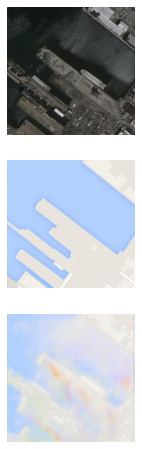

Epoch: 1
Step: 200/1101


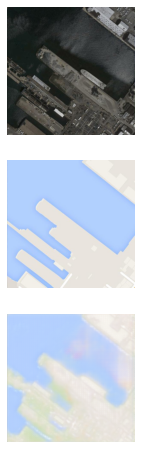

Epoch: 1
Step: 300/1101


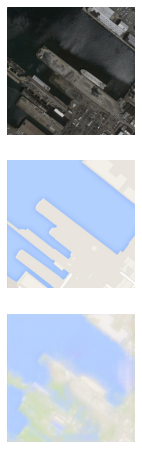

Epoch: 1
Step: 400/1101


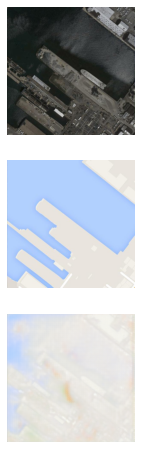

Epoch: 1
Step: 500/1101


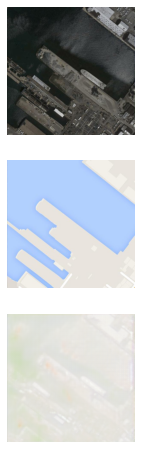

Epoch: 1
Step: 600/1101


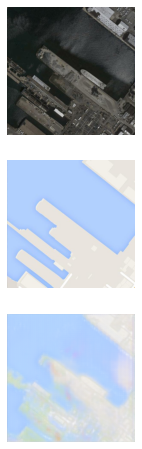

Epoch: 1
Step: 700/1101


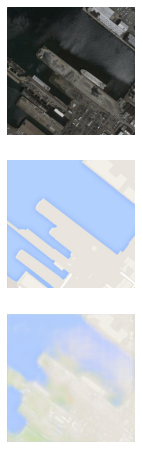

Epoch: 1
Step: 800/1101


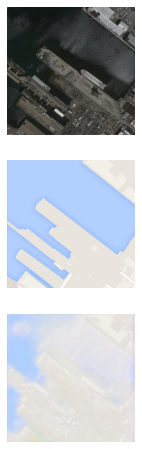

Epoch: 1
Step: 900/1101


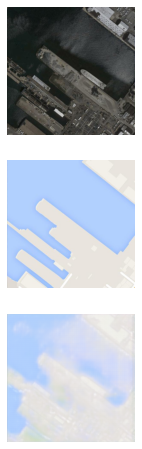

Epoch: 1
Step: 1000/1101


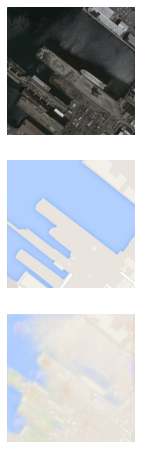

Epoch: 1
Step: 1100/1101


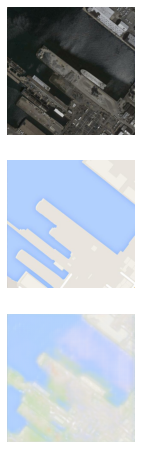

  0%|          | 0/1101 [00:00<?, ?it/s]

Epoch: 2
Step: 100/1101


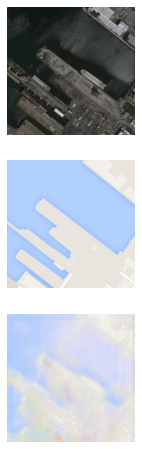

Epoch: 2
Step: 200/1101


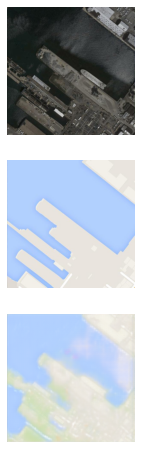

Epoch: 2
Step: 300/1101


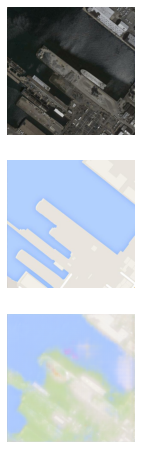

Epoch: 2
Step: 400/1101


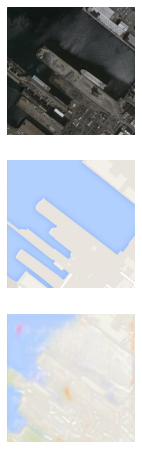

Epoch: 2
Step: 500/1101


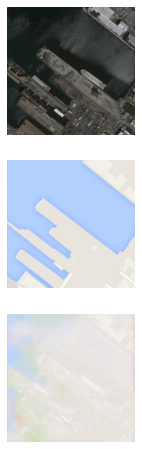

Epoch: 2
Step: 600/1101


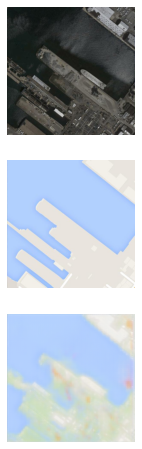

Epoch: 2
Step: 700/1101


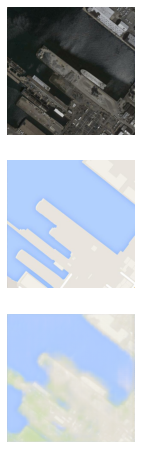

Epoch: 2
Step: 800/1101


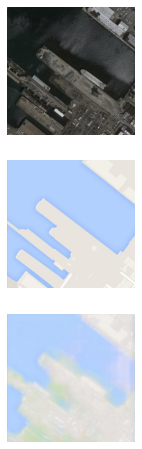

Epoch: 2
Step: 900/1101


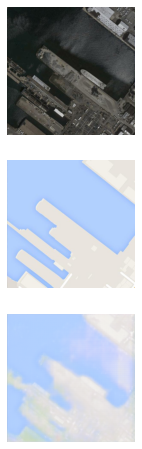

Epoch: 2
Step: 1000/1101


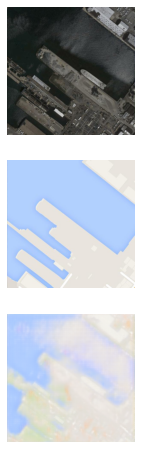

Epoch: 2
Step: 1100/1101


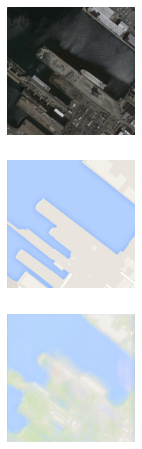

  0%|          | 0/1101 [00:00<?, ?it/s]

Epoch: 3
Step: 100/1101


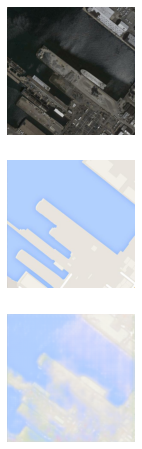

Epoch: 3
Step: 200/1101


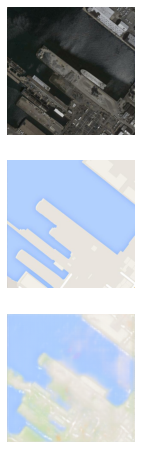

Epoch: 3
Step: 300/1101


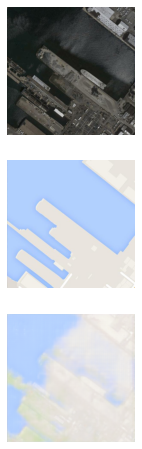

Epoch: 3
Step: 400/1101


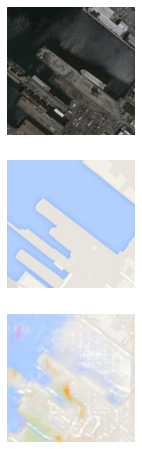

Epoch: 3
Step: 500/1101


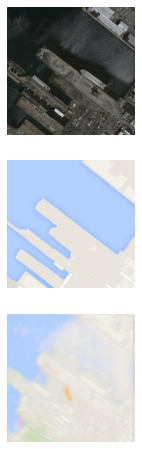

Epoch: 3
Step: 600/1101


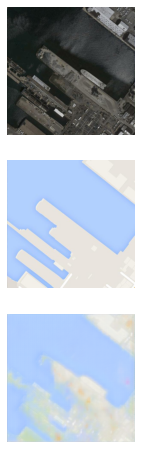

Epoch: 3
Step: 700/1101


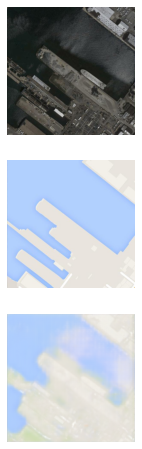

Epoch: 3
Step: 800/1101


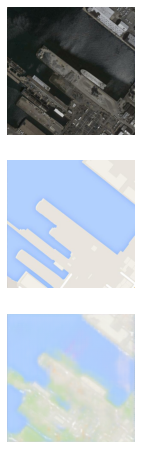

Epoch: 3
Step: 900/1101


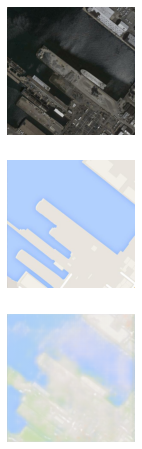

Epoch: 3
Step: 1000/1101


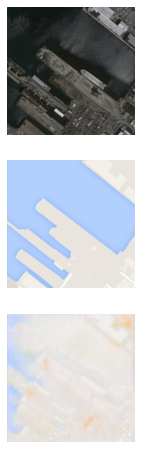

Epoch: 3
Step: 1100/1101


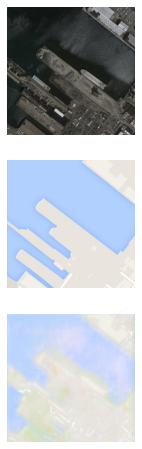

  0%|          | 0/1101 [00:00<?, ?it/s]

Epoch: 4
Step: 100/1101


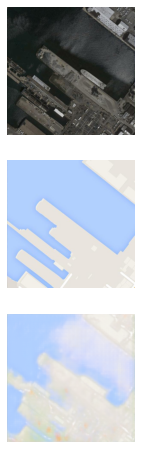

Epoch: 4
Step: 200/1101


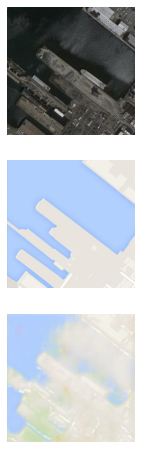

Epoch: 4
Step: 300/1101


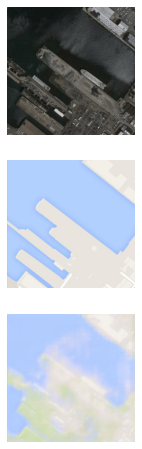

Epoch: 4
Step: 400/1101


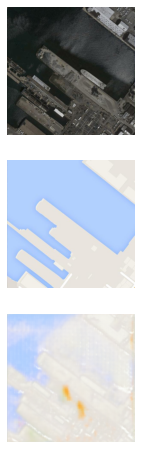

Epoch: 4
Step: 500/1101


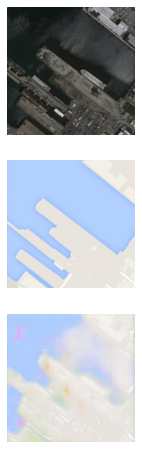

Epoch: 4
Step: 600/1101


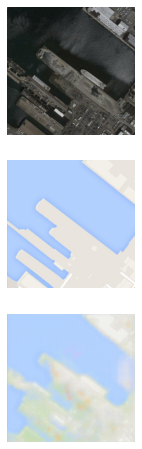

Epoch: 4
Step: 700/1101


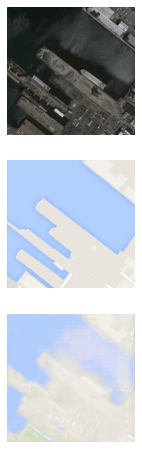

Epoch: 4
Step: 800/1101


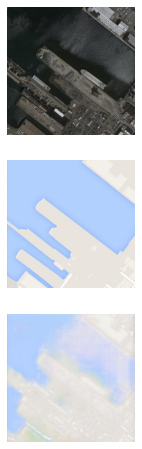

Epoch: 4
Step: 900/1101


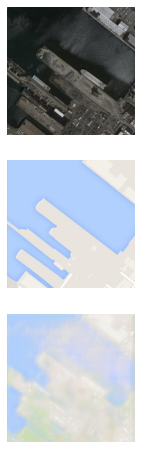

Epoch: 4
Step: 1000/1101


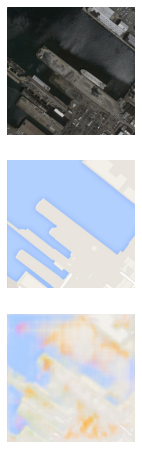

Epoch: 4
Step: 1100/1101


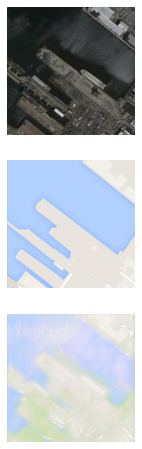

  0%|          | 0/1101 [00:00<?, ?it/s]

Epoch: 5
Step: 100/1101


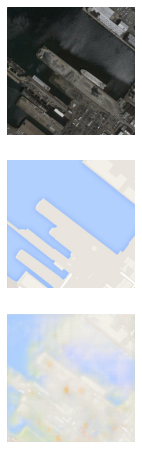

Epoch: 5
Step: 200/1101


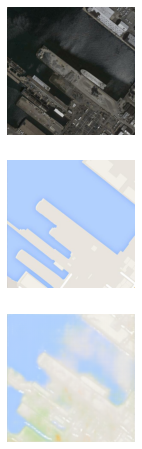

Epoch: 5
Step: 300/1101


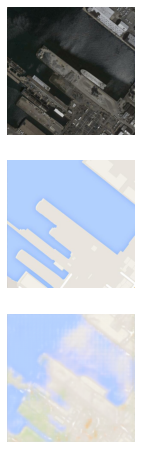

Epoch: 5
Step: 400/1101


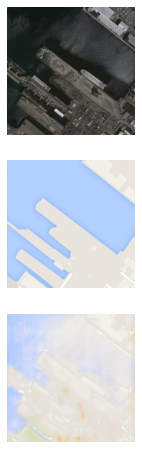

Epoch: 5
Step: 500/1101


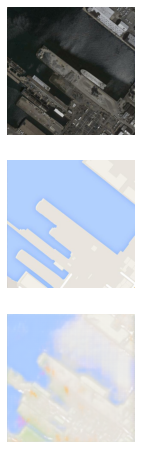

Epoch: 5
Step: 600/1101


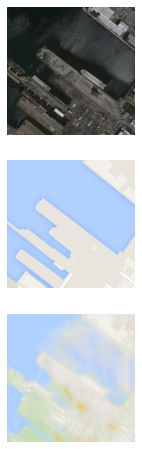

Epoch: 5
Step: 700/1101


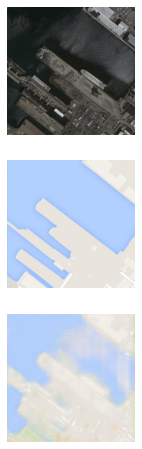

Epoch: 5
Step: 800/1101


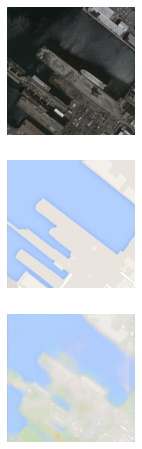

Epoch: 5
Step: 900/1101


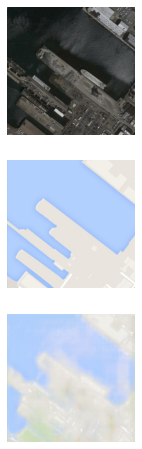

Epoch: 5
Step: 1000/1101


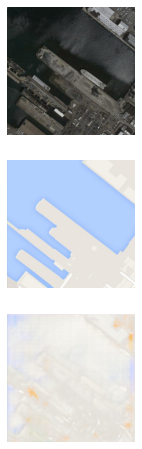

Epoch: 5
Step: 1100/1101


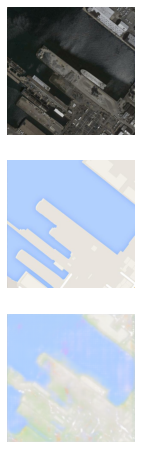

  0%|          | 0/1101 [00:00<?, ?it/s]

Epoch: 6
Step: 100/1101


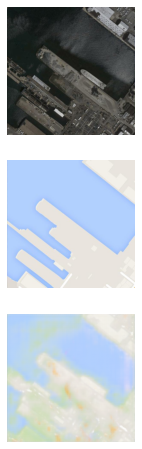

Epoch: 6
Step: 200/1101


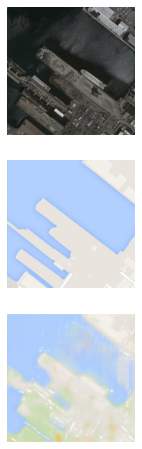

Epoch: 6
Step: 300/1101


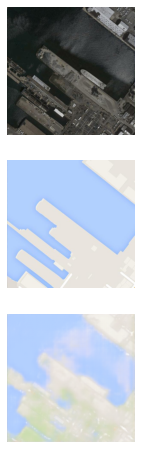

Epoch: 6
Step: 400/1101


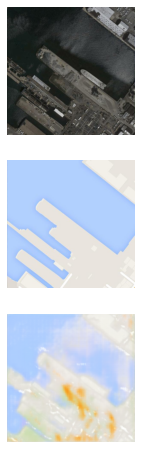

Epoch: 6
Step: 500/1101


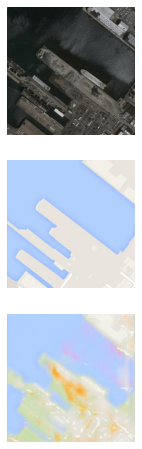

Epoch: 6
Step: 600/1101


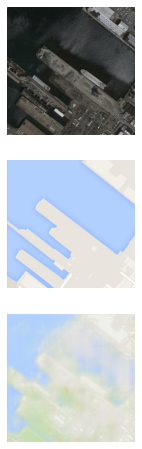

Epoch: 6
Step: 700/1101


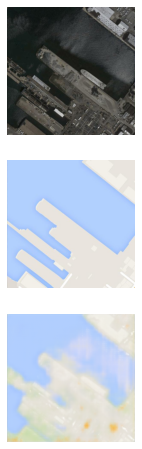

Epoch: 6
Step: 800/1101


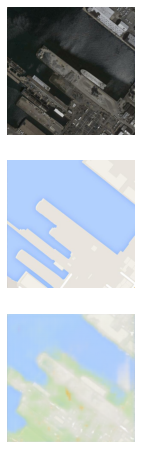

Epoch: 6
Step: 900/1101


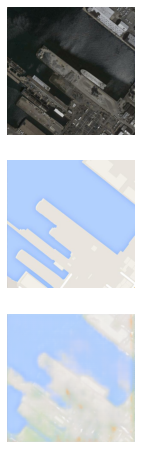

Epoch: 6
Step: 1000/1101


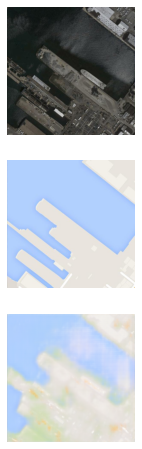

Epoch: 6
Step: 1100/1101


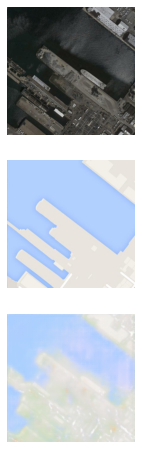

  0%|          | 0/1101 [00:00<?, ?it/s]

Epoch: 7
Step: 100/1101


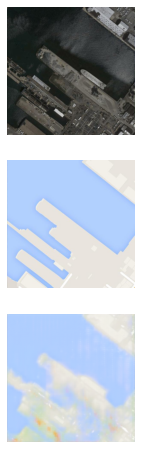

Epoch: 7
Step: 200/1101


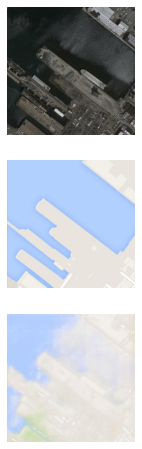

Epoch: 7
Step: 300/1101


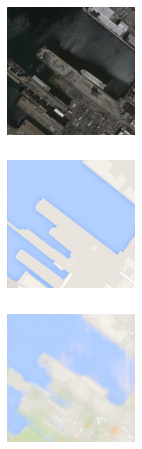

Epoch: 7
Step: 400/1101


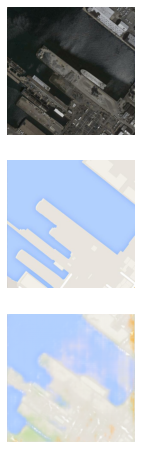

Epoch: 7
Step: 500/1101


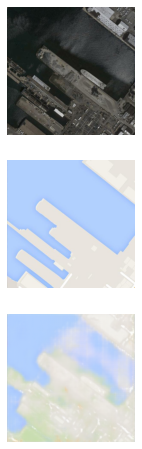

Epoch: 7
Step: 600/1101


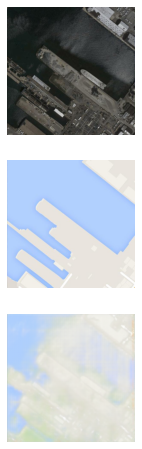

Epoch: 7
Step: 700/1101


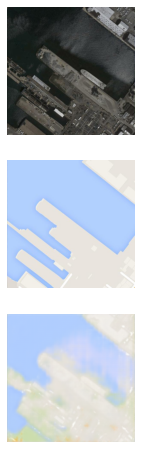

Epoch: 7
Step: 800/1101


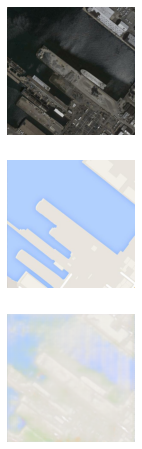

Epoch: 7
Step: 900/1101


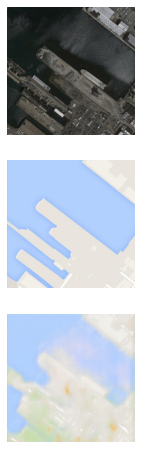

Epoch: 7
Step: 1000/1101


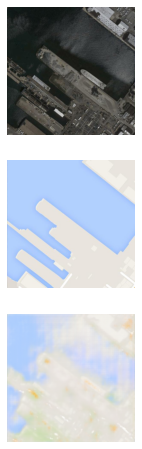

Epoch: 7
Step: 1100/1101


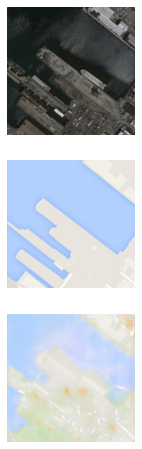

  0%|          | 0/1101 [00:00<?, ?it/s]

Epoch: 8
Step: 100/1101


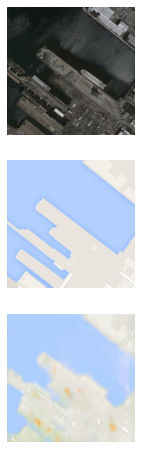

Epoch: 8
Step: 200/1101


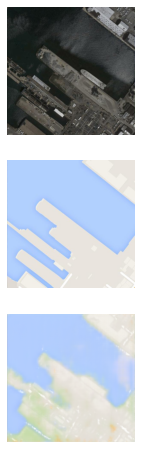

Epoch: 8
Step: 300/1101


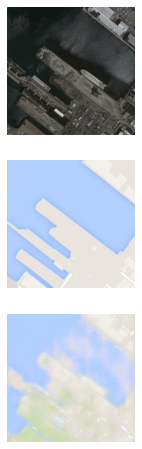

Epoch: 8
Step: 400/1101


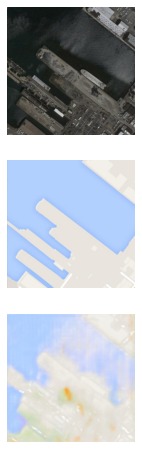

Epoch: 8
Step: 500/1101


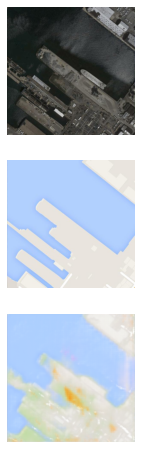

Epoch: 8
Step: 600/1101


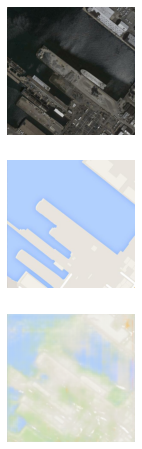

Epoch: 8
Step: 700/1101


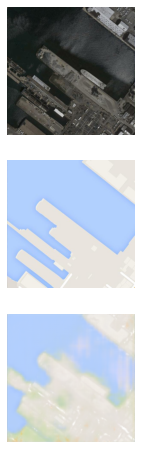

Epoch: 8
Step: 800/1101


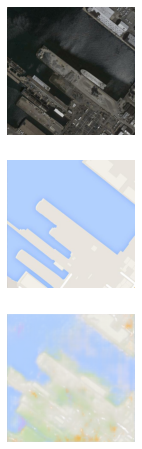

Epoch: 8
Step: 900/1101


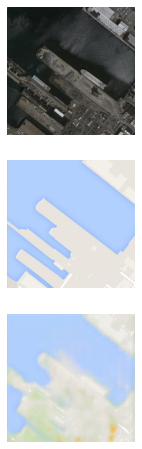

Epoch: 8
Step: 1000/1101


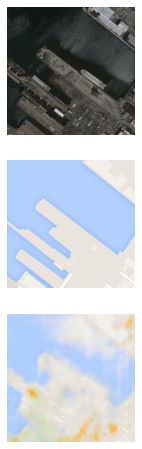

Epoch: 8
Step: 1100/1101


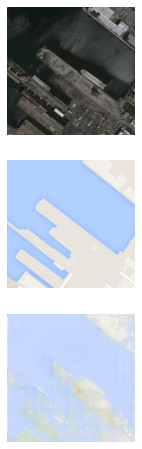

  0%|          | 0/1101 [00:00<?, ?it/s]

Epoch: 9
Step: 100/1101


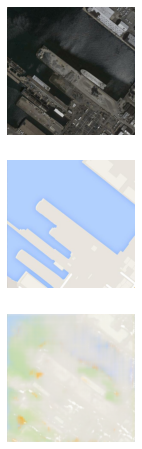

Epoch: 9
Step: 200/1101


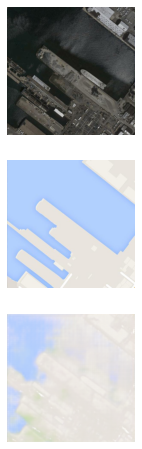

Epoch: 9
Step: 300/1101


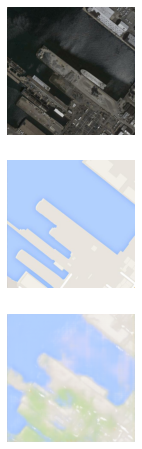

Epoch: 9
Step: 400/1101


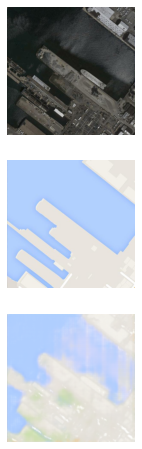

Epoch: 9
Step: 500/1101


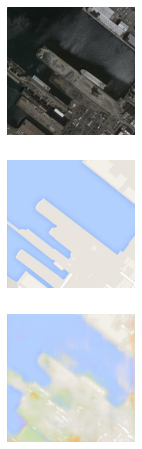

Epoch: 9
Step: 600/1101


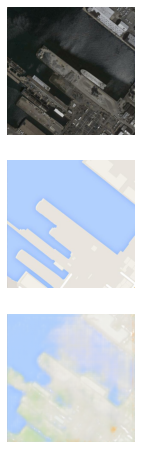

Epoch: 9
Step: 700/1101


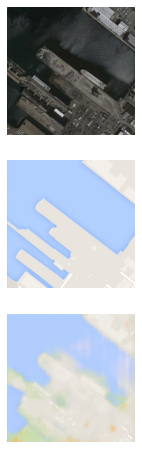

Epoch: 9
Step: 800/1101


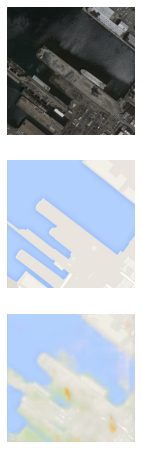

Epoch: 9
Step: 900/1101


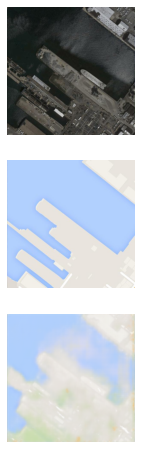

Epoch: 9
Step: 1000/1101


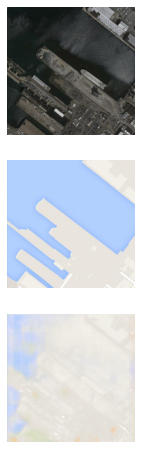

Epoch: 9
Step: 1100/1101


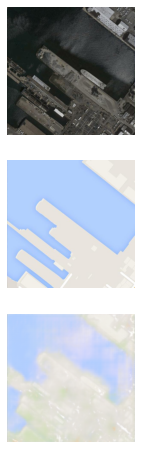

  0%|          | 0/1101 [00:00<?, ?it/s]

Epoch: 10
Step: 100/1101


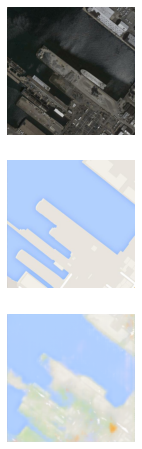

Epoch: 10
Step: 200/1101


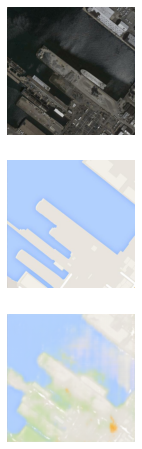

Epoch: 10
Step: 300/1101


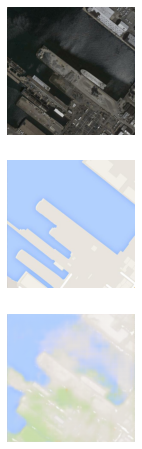

Epoch: 10
Step: 400/1101


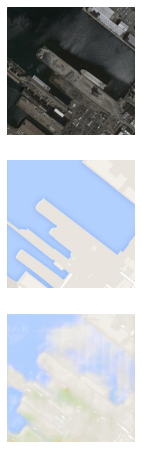

Epoch: 10
Step: 500/1101


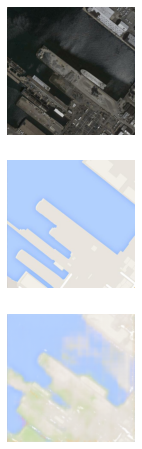

Epoch: 10
Step: 600/1101


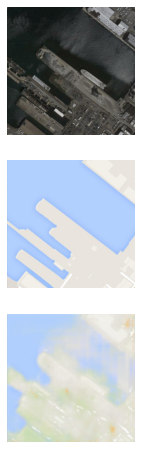

Epoch: 10
Step: 700/1101


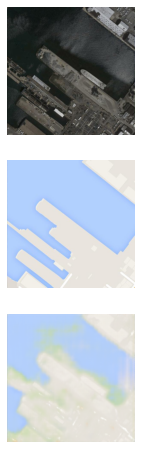

Epoch: 10
Step: 800/1101


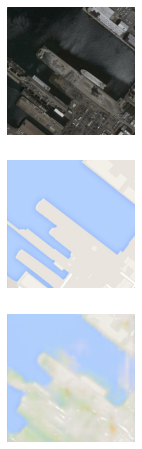

Epoch: 10
Step: 900/1101


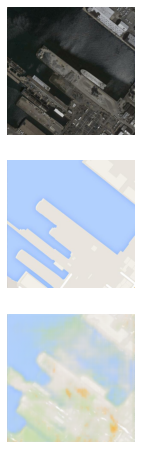

Epoch: 10
Step: 1000/1101


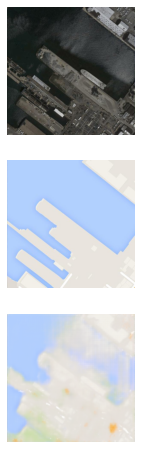

Epoch: 10
Step: 1100/1101


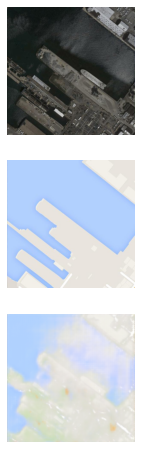

  0%|          | 0/1101 [00:00<?, ?it/s]

Epoch: 11
Step: 100/1101


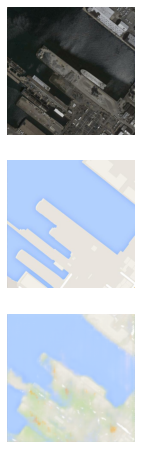

Epoch: 11
Step: 200/1101


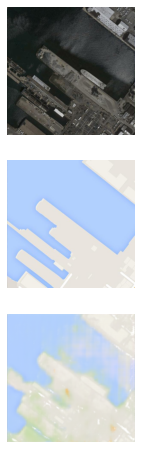

Epoch: 11
Step: 300/1101


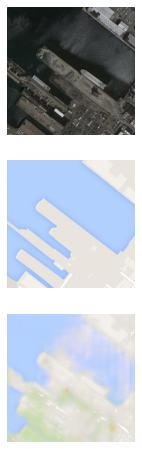

Epoch: 11
Step: 400/1101


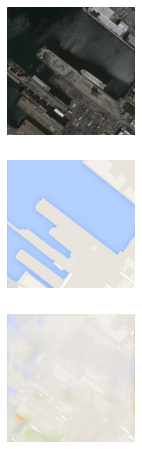

Epoch: 11
Step: 500/1101


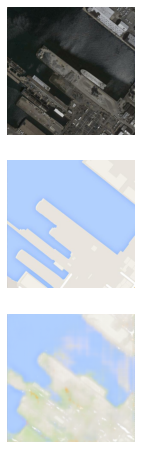

Epoch: 11
Step: 600/1101


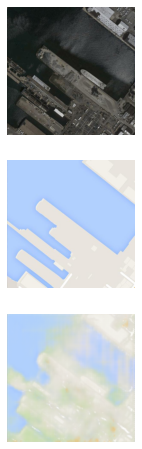

Epoch: 11
Step: 700/1101


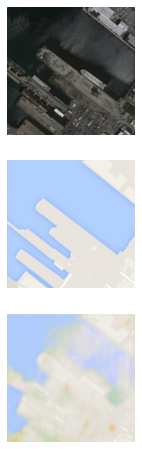

Epoch: 11
Step: 800/1101


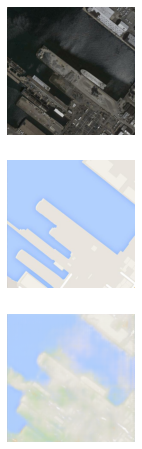

Epoch: 11
Step: 900/1101


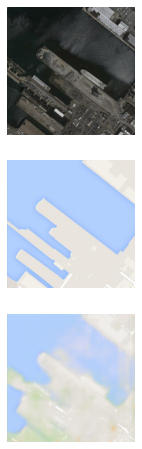

Epoch: 11
Step: 1000/1101


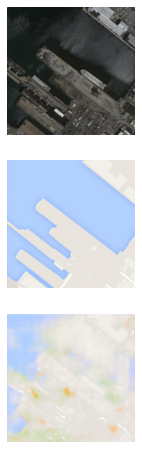

Epoch: 11
Step: 1100/1101


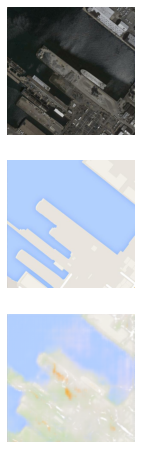

  0%|          | 0/1101 [00:00<?, ?it/s]

Epoch: 12
Step: 100/1101


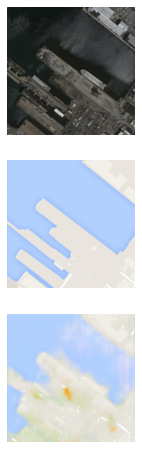

Epoch: 12
Step: 200/1101


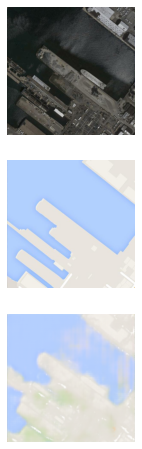

Epoch: 12
Step: 300/1101


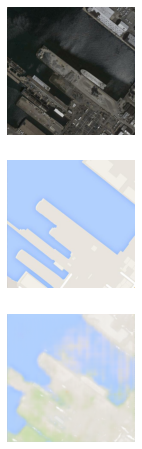

Epoch: 12
Step: 400/1101


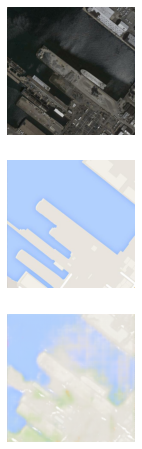

Epoch: 12
Step: 500/1101


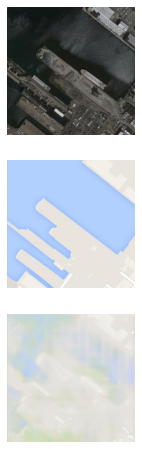

Epoch: 12
Step: 600/1101


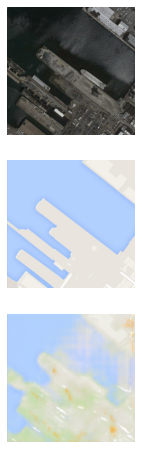

Epoch: 12
Step: 700/1101


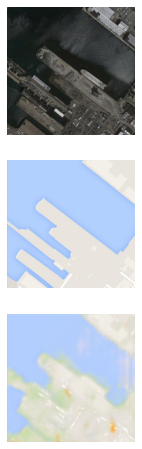

Epoch: 12
Step: 800/1101


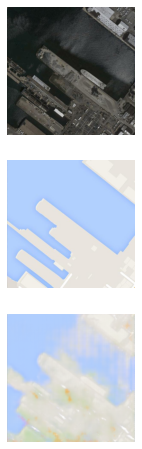

Epoch: 12
Step: 900/1101


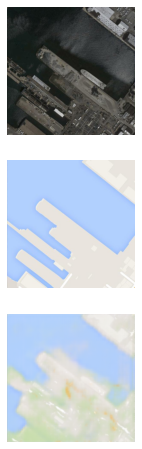

Epoch: 12
Step: 1000/1101


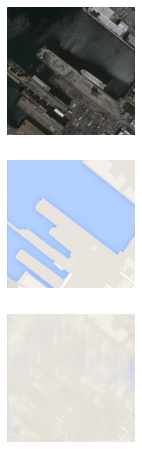

Epoch: 12
Step: 1100/1101


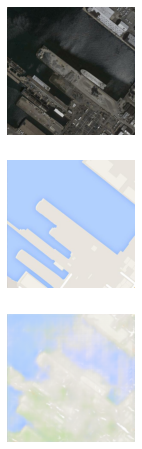

  0%|          | 0/1101 [00:00<?, ?it/s]

Epoch: 13
Step: 100/1101


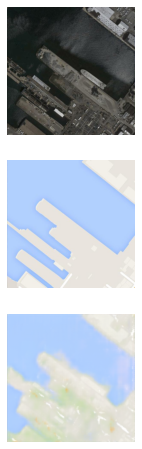

Epoch: 13
Step: 200/1101


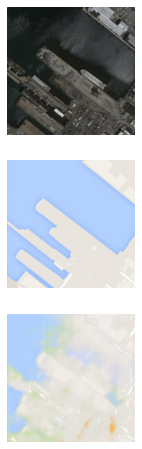

Epoch: 13
Step: 300/1101


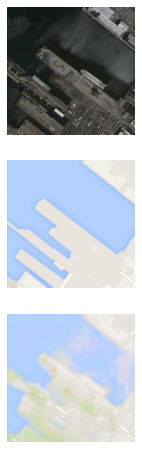

Epoch: 13
Step: 400/1101


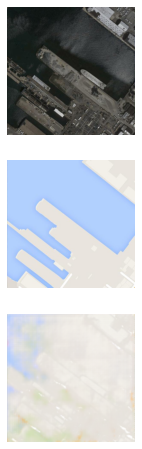

Epoch: 13
Step: 500/1101


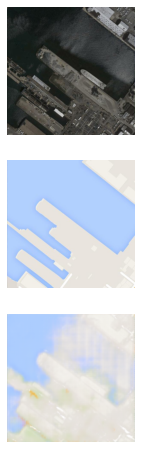

Epoch: 13
Step: 600/1101


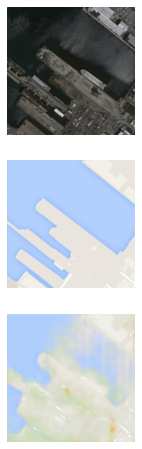

Epoch: 13
Step: 700/1101


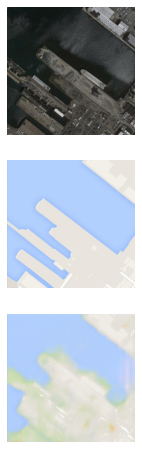

Epoch: 13
Step: 800/1101


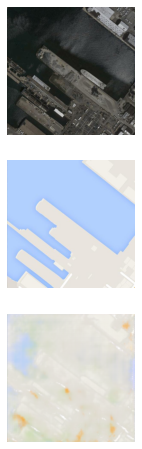

Epoch: 13
Step: 900/1101


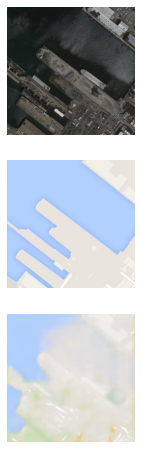

Epoch: 13
Step: 1000/1101


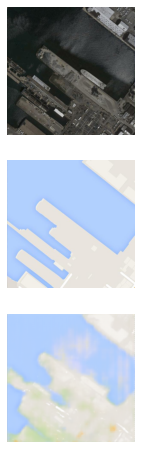

Epoch: 13
Step: 1100/1101


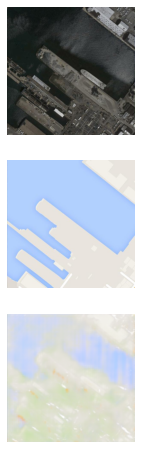

  0%|          | 0/1101 [00:00<?, ?it/s]

Epoch: 14
Step: 100/1101


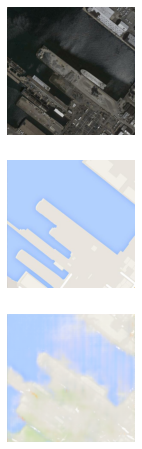

Epoch: 14
Step: 200/1101


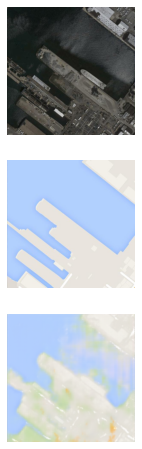

Epoch: 14
Step: 300/1101


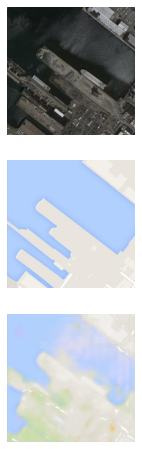

Epoch: 14
Step: 400/1101


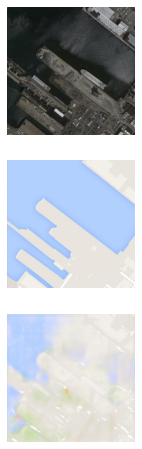

Epoch: 14
Step: 500/1101


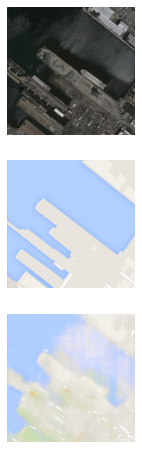

Epoch: 14
Step: 600/1101


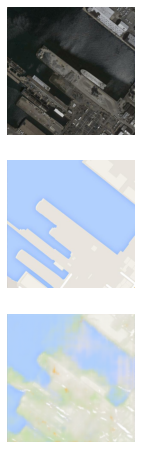

Epoch: 14
Step: 700/1101


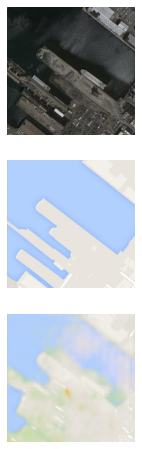

Epoch: 14
Step: 800/1101


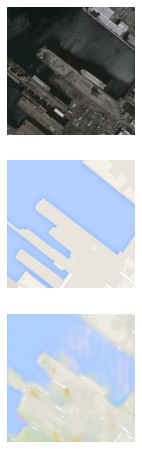

Epoch: 14
Step: 900/1101


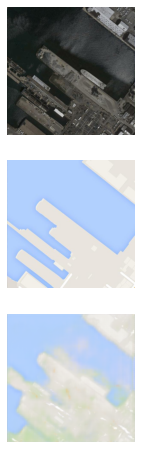

Epoch: 14
Step: 1000/1101


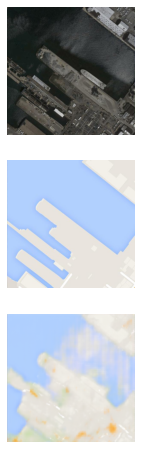

Epoch: 14
Step: 1100/1101


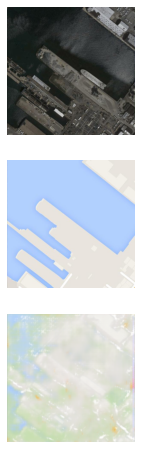

  0%|          | 0/1101 [00:00<?, ?it/s]

Epoch: 15
Step: 100/1101


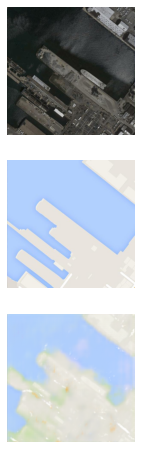

Epoch: 15
Step: 200/1101


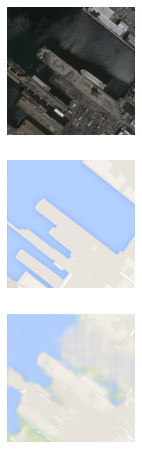

Epoch: 15
Step: 300/1101


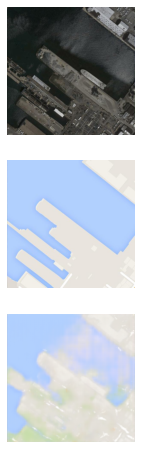

Epoch: 15
Step: 400/1101


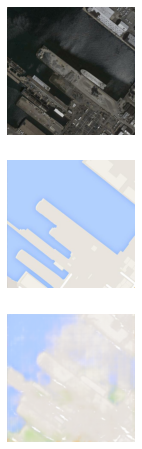

Epoch: 15
Step: 500/1101


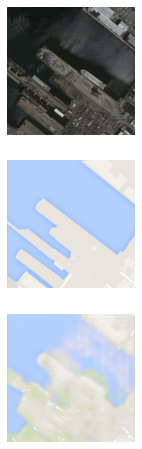

Epoch: 15
Step: 600/1101


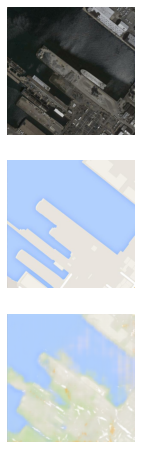

Epoch: 15
Step: 700/1101


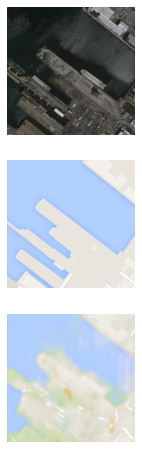

Epoch: 15
Step: 800/1101


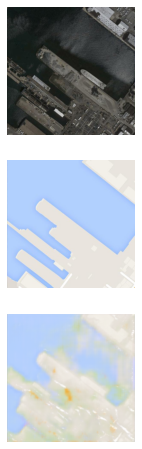

Epoch: 15
Step: 900/1101


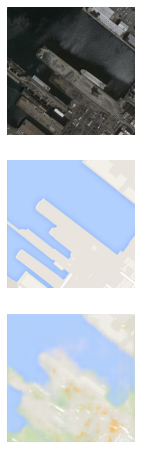

Epoch: 15
Step: 1000/1101


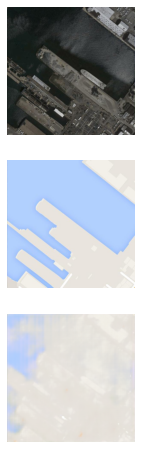

Epoch: 15
Step: 1100/1101


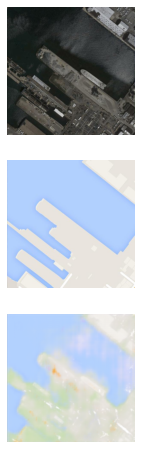

  0%|          | 0/1101 [00:00<?, ?it/s]

Epoch: 16
Step: 100/1101


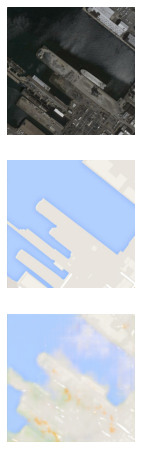

Epoch: 16
Step: 200/1101


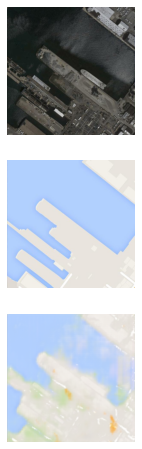

Epoch: 16
Step: 300/1101


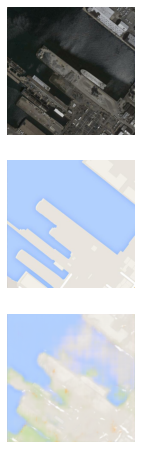

Epoch: 16
Step: 400/1101


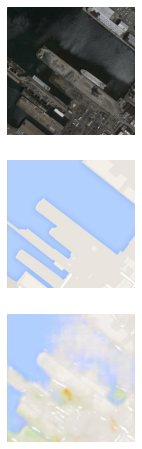

Epoch: 16
Step: 500/1101


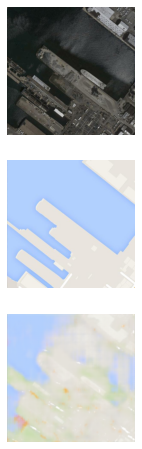

Epoch: 16
Step: 600/1101


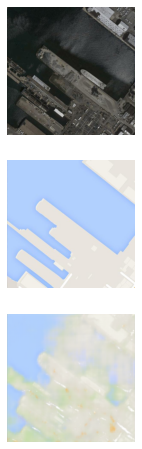

Epoch: 16
Step: 700/1101


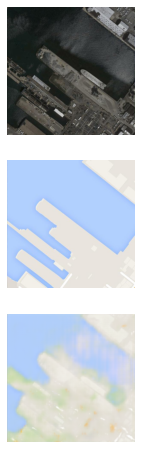

Epoch: 16
Step: 800/1101


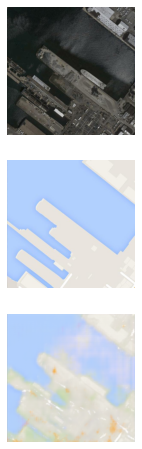

Epoch: 16
Step: 900/1101


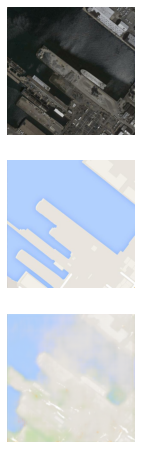

Epoch: 16
Step: 1000/1101


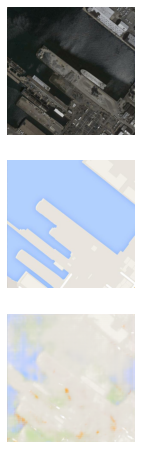

Epoch: 16
Step: 1100/1101


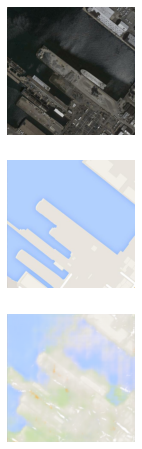

  0%|          | 0/1101 [00:00<?, ?it/s]

Epoch: 17
Step: 100/1101


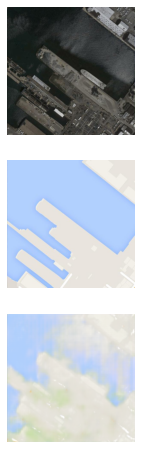

Epoch: 17
Step: 200/1101


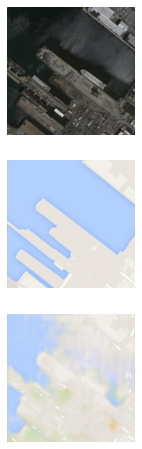

Epoch: 17
Step: 300/1101


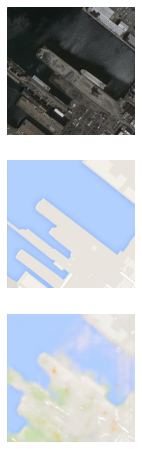

Epoch: 17
Step: 400/1101


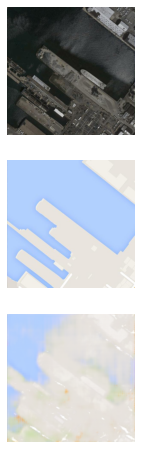

Epoch: 17
Step: 500/1101


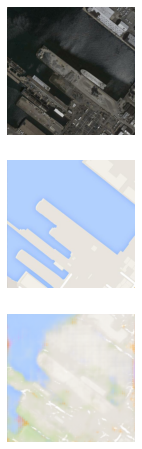

Epoch: 17
Step: 600/1101


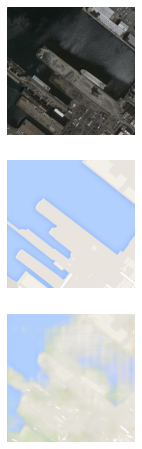

Epoch: 17
Step: 700/1101


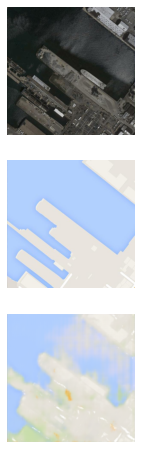

Epoch: 17
Step: 800/1101


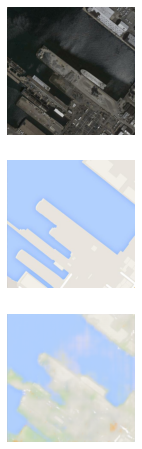

Epoch: 17
Step: 900/1101


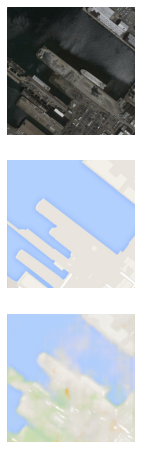

Epoch: 17
Step: 1000/1101


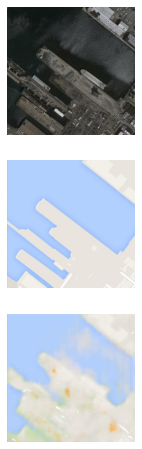

Epoch: 17
Step: 1100/1101


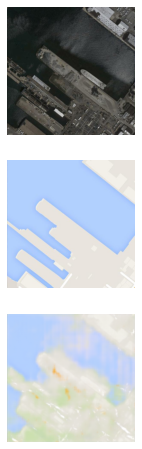

  0%|          | 0/1101 [00:00<?, ?it/s]

Epoch: 18
Step: 100/1101


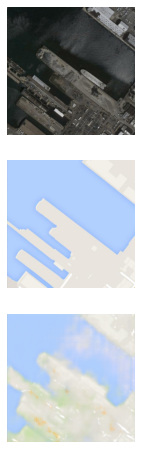

Epoch: 18
Step: 200/1101


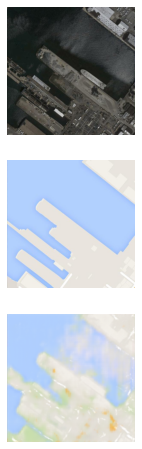

Epoch: 18
Step: 300/1101


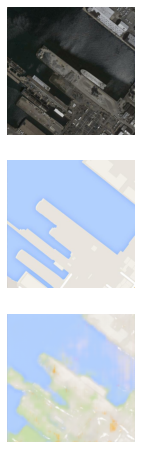

Epoch: 18
Step: 400/1101


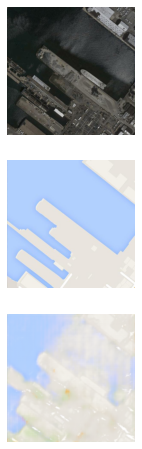

Epoch: 18
Step: 500/1101


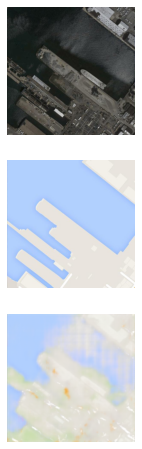

Epoch: 18
Step: 600/1101


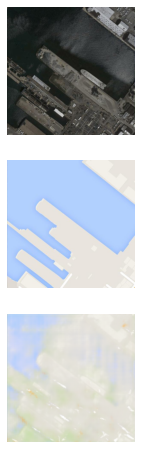

Epoch: 18
Step: 700/1101


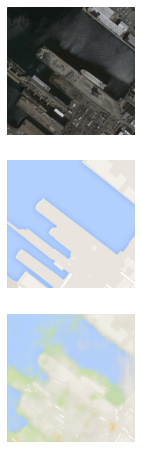

Epoch: 18
Step: 800/1101


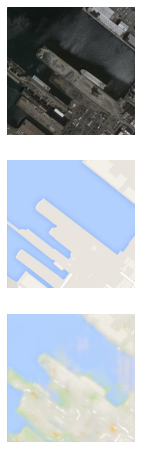

Epoch: 18
Step: 900/1101


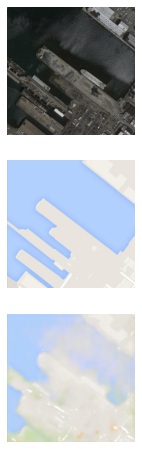

Epoch: 18
Step: 1000/1101


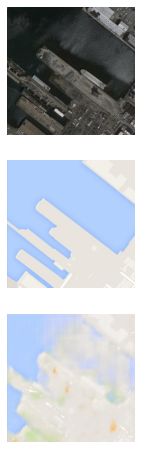

Epoch: 18
Step: 1100/1101


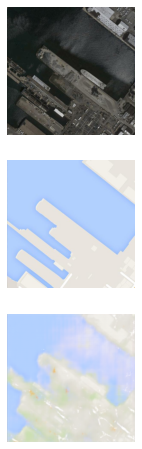

  0%|          | 0/1101 [00:00<?, ?it/s]

Epoch: 19
Step: 100/1101


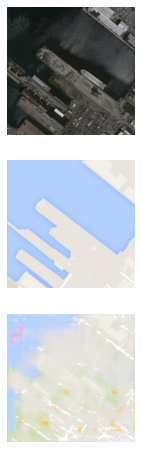

Epoch: 19
Step: 200/1101


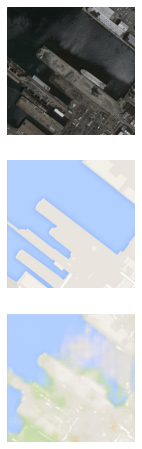

Epoch: 19
Step: 300/1101


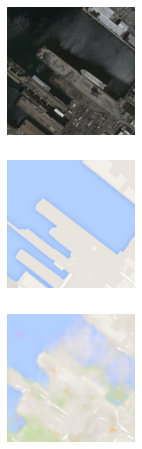

Epoch: 19
Step: 400/1101


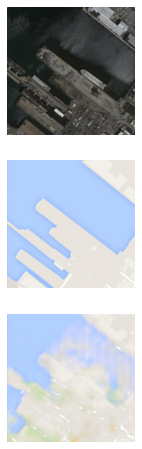

Epoch: 19
Step: 500/1101


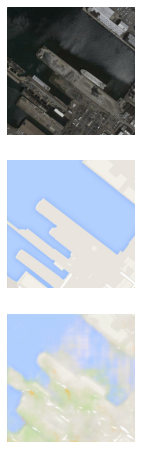

Epoch: 19
Step: 600/1101


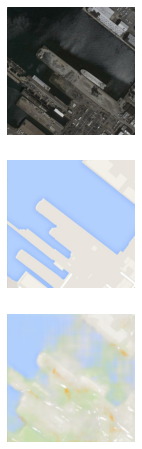

Epoch: 19
Step: 700/1101


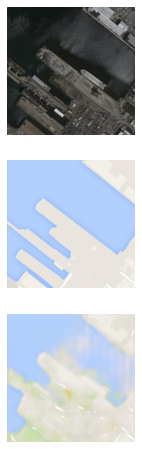

Epoch: 19
Step: 800/1101


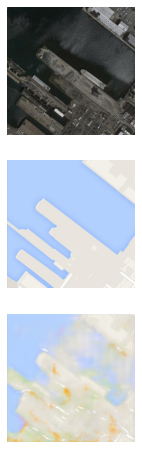

Epoch: 19
Step: 900/1101


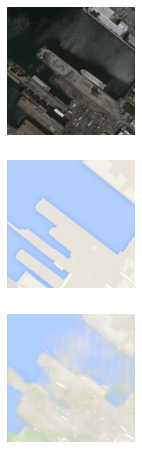

Epoch: 19
Step: 1000/1101


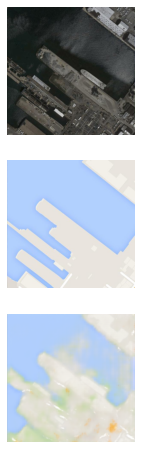

Epoch: 19
Step: 1100/1101


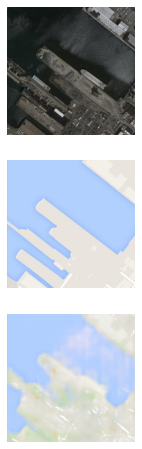

  0%|          | 0/1101 [00:00<?, ?it/s]

Epoch: 20
Step: 100/1101


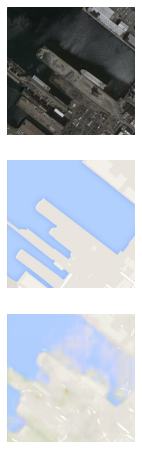

Epoch: 20
Step: 200/1101


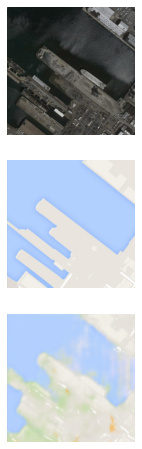

Epoch: 20
Step: 300/1101


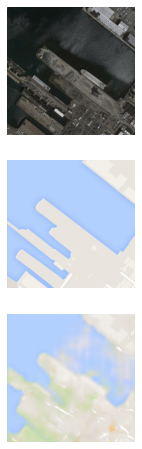

Epoch: 20
Step: 400/1101


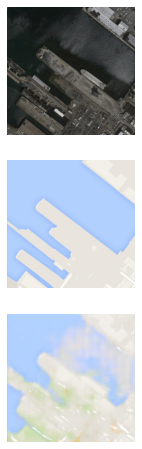

Epoch: 20
Step: 500/1101


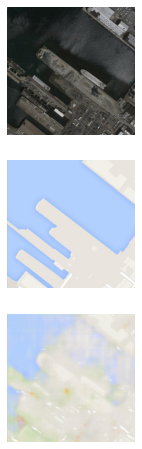

Epoch: 20
Step: 600/1101


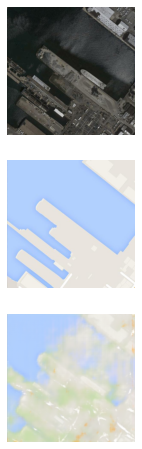

Epoch: 20
Step: 700/1101


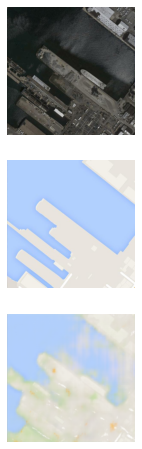

Epoch: 20
Step: 800/1101


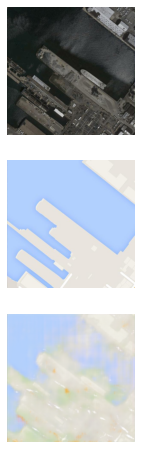

Epoch: 20
Step: 900/1101


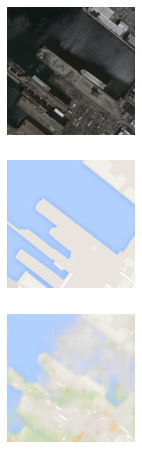

Epoch: 20
Step: 1000/1101


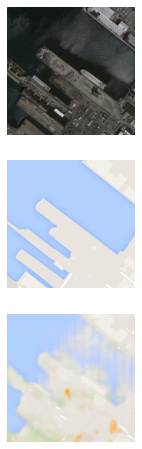

Epoch: 20
Step: 1100/1101


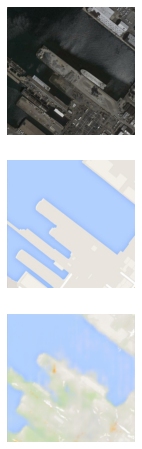

  0%|          | 0/1101 [00:00<?, ?it/s]

Epoch: 21
Step: 100/1101


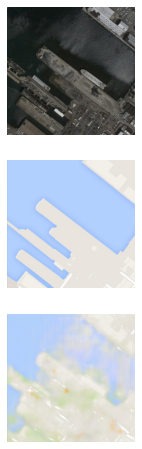

Epoch: 21
Step: 200/1101


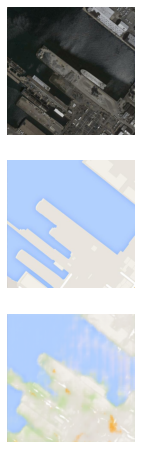

Epoch: 21
Step: 300/1101


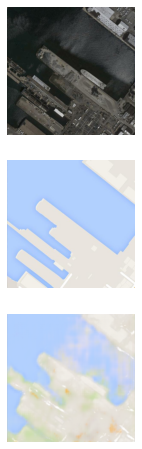

Epoch: 21
Step: 400/1101


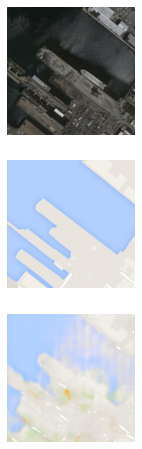

Epoch: 21
Step: 500/1101


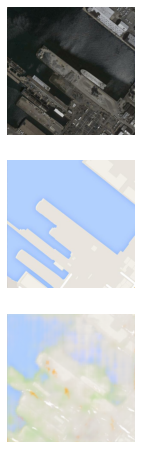

Epoch: 21
Step: 600/1101


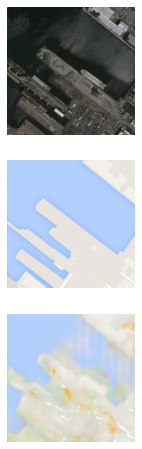

Epoch: 21
Step: 700/1101


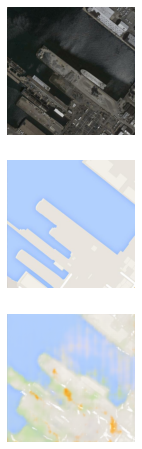

Epoch: 21
Step: 800/1101


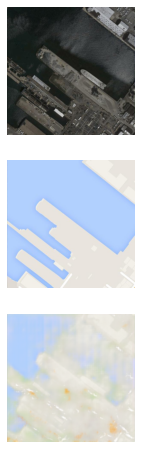

Epoch: 21
Step: 900/1101


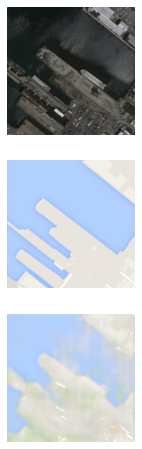

Epoch: 21
Step: 1000/1101


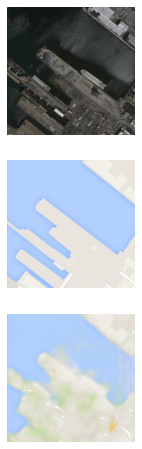

Epoch: 21
Step: 1100/1101


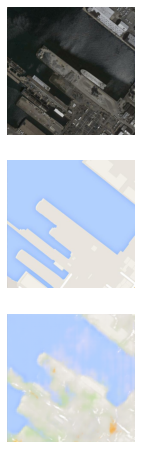

  0%|          | 0/1101 [00:00<?, ?it/s]

Epoch: 22
Step: 100/1101


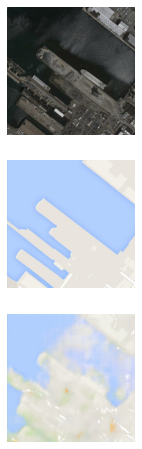

Epoch: 22
Step: 200/1101


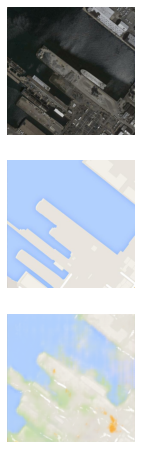

Epoch: 22
Step: 300/1101


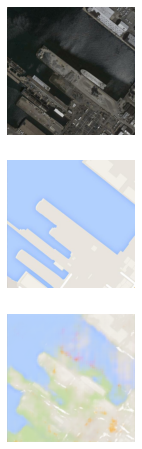

Epoch: 22
Step: 400/1101


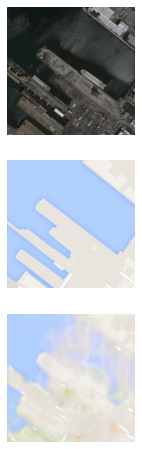

Epoch: 22
Step: 500/1101


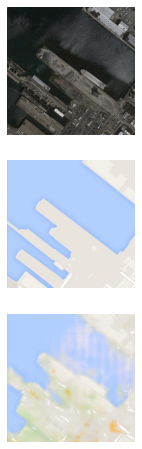

Epoch: 22
Step: 600/1101


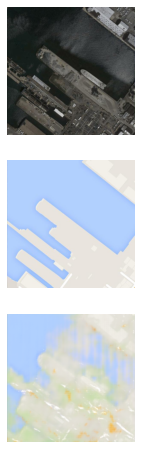

Epoch: 22
Step: 700/1101


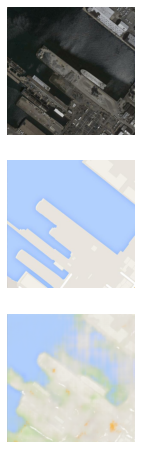

Epoch: 22
Step: 800/1101


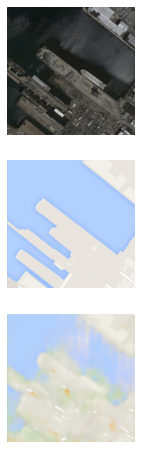

Epoch: 22
Step: 900/1101


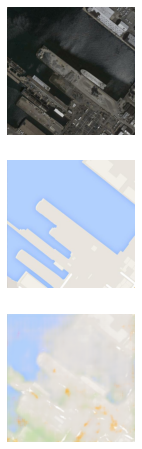

Epoch: 22
Step: 1000/1101


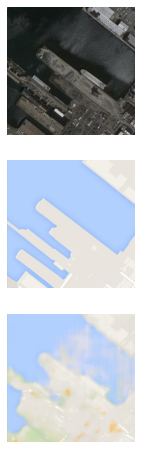

Epoch: 22
Step: 1100/1101


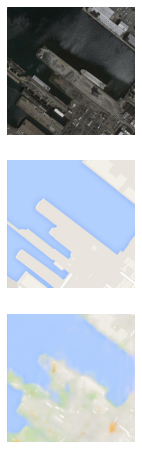

  0%|          | 0/1101 [00:00<?, ?it/s]

Epoch: 23
Step: 100/1101


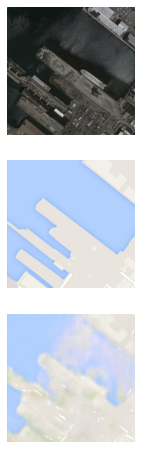

Epoch: 23
Step: 200/1101


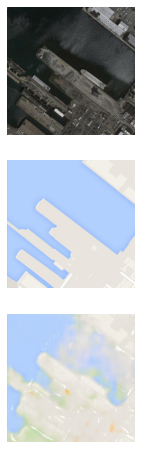

Epoch: 23
Step: 300/1101


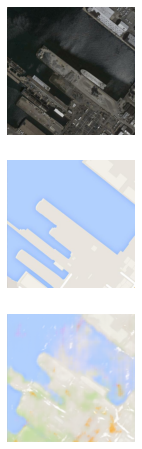

Epoch: 23
Step: 400/1101


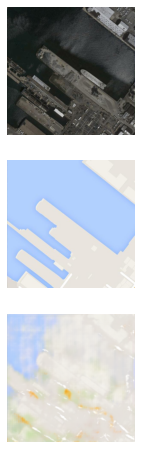

Epoch: 23
Step: 500/1101


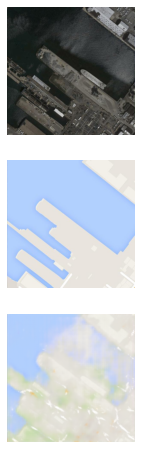

Epoch: 23
Step: 600/1101


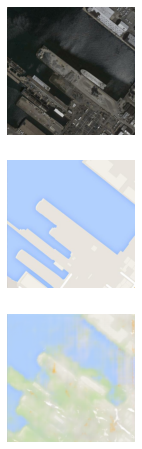

Epoch: 23
Step: 700/1101


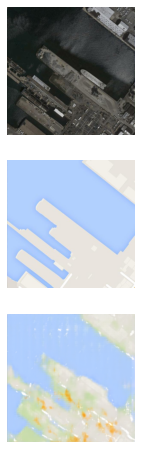

Epoch: 23
Step: 800/1101


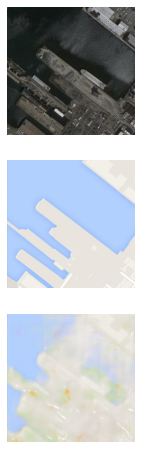

Epoch: 23
Step: 900/1101


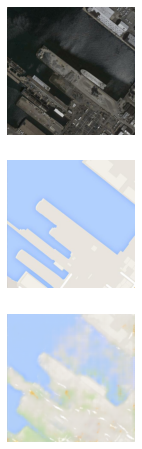

Epoch: 23
Step: 1000/1101


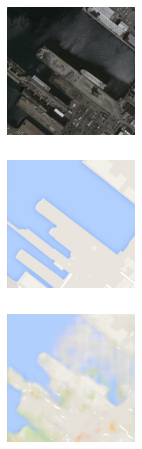

Epoch: 23
Step: 1100/1101


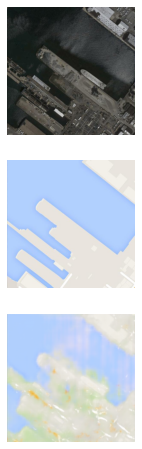

  0%|          | 0/1101 [00:00<?, ?it/s]

Epoch: 24
Step: 100/1101


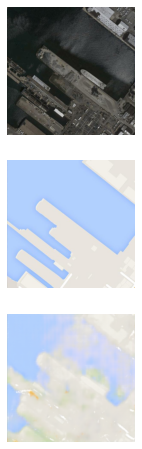

Epoch: 24
Step: 200/1101


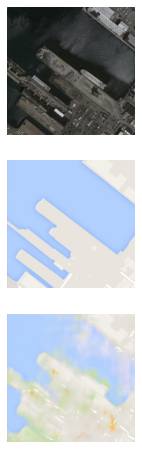

Epoch: 24
Step: 300/1101


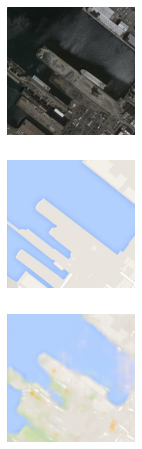

Epoch: 24
Step: 400/1101


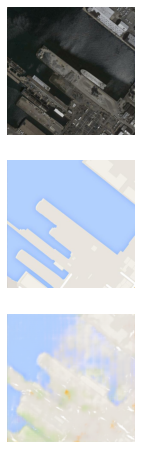

Epoch: 24
Step: 500/1101


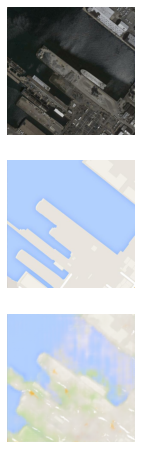

Epoch: 24
Step: 600/1101


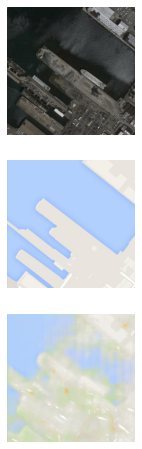

Epoch: 24
Step: 700/1101


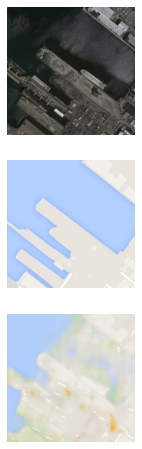

Epoch: 24
Step: 800/1101


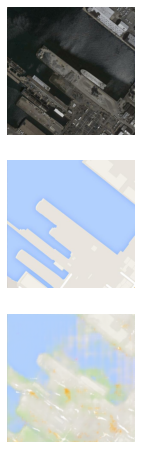

Epoch: 24
Step: 900/1101


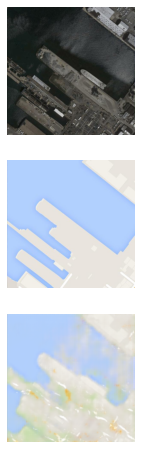

Epoch: 24
Step: 1000/1101


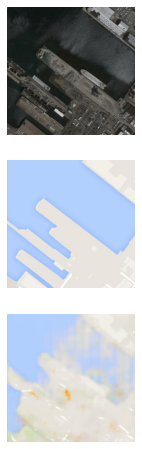

Epoch: 24
Step: 1100/1101


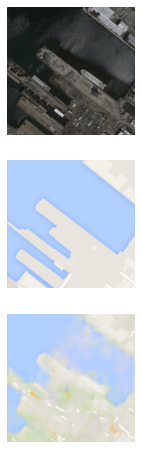

  0%|          | 0/1101 [00:00<?, ?it/s]

Epoch: 25
Step: 100/1101


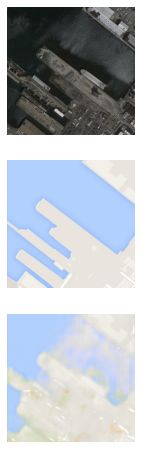

Epoch: 25
Step: 200/1101


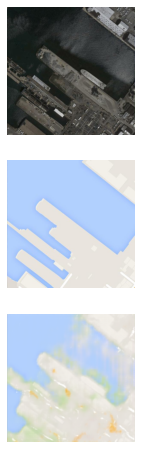

Epoch: 25
Step: 300/1101


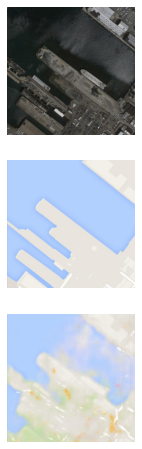

Epoch: 25
Step: 400/1101


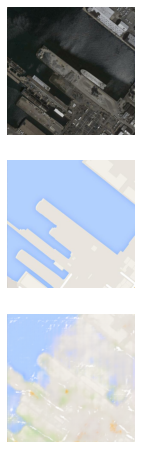

Epoch: 25
Step: 500/1101


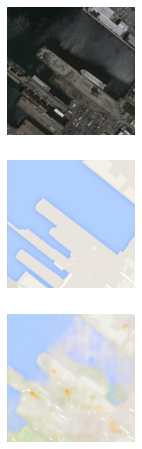

Epoch: 25
Step: 600/1101


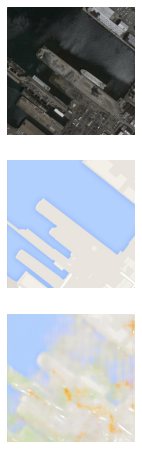

Epoch: 25
Step: 700/1101


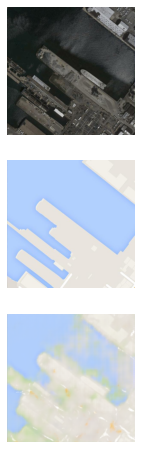

Epoch: 25
Step: 800/1101


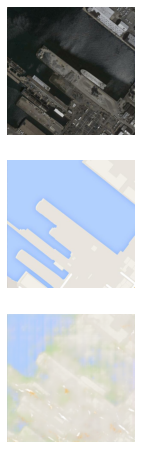

Epoch: 25
Step: 900/1101


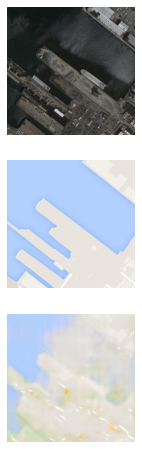

Epoch: 25
Step: 1000/1101


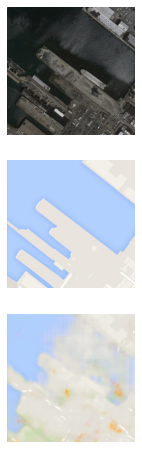

Epoch: 25
Step: 1100/1101


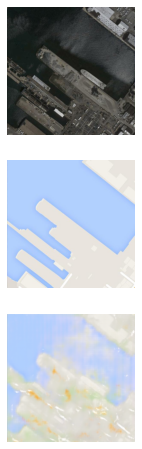

  0%|          | 0/1101 [00:00<?, ?it/s]

Epoch: 26
Step: 100/1101


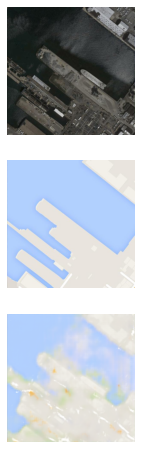

Epoch: 26
Step: 200/1101


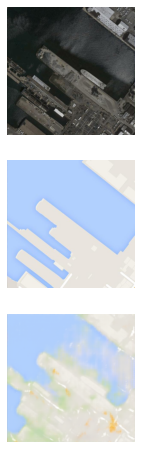

Epoch: 26
Step: 300/1101


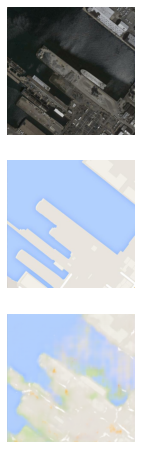

Epoch: 26
Step: 400/1101


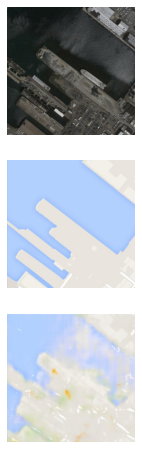

Epoch: 26
Step: 500/1101


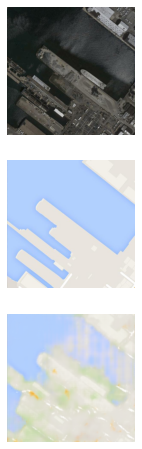

Epoch: 26
Step: 600/1101


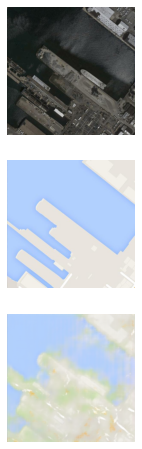

Epoch: 26
Step: 700/1101


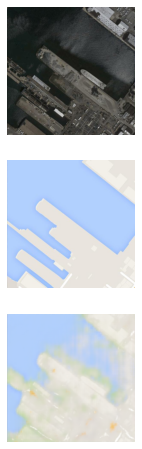

Epoch: 26
Step: 800/1101


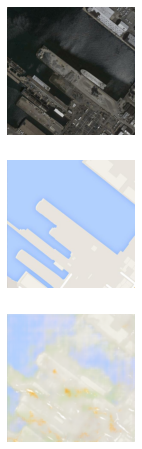

Epoch: 26
Step: 900/1101


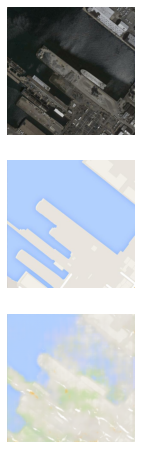

Epoch: 26
Step: 1000/1101


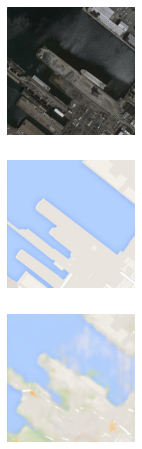

Epoch: 26
Step: 1100/1101


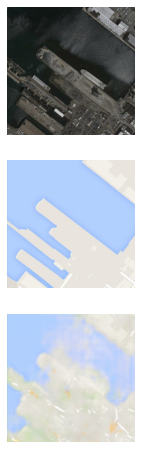

  0%|          | 0/1101 [00:00<?, ?it/s]

Epoch: 27
Step: 100/1101


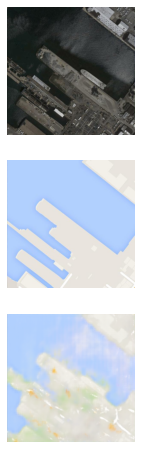

Epoch: 27
Step: 200/1101


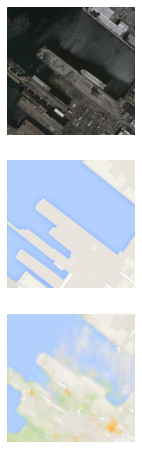

Epoch: 27
Step: 300/1101


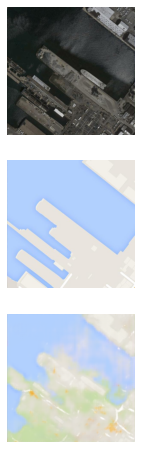

Epoch: 27
Step: 400/1101


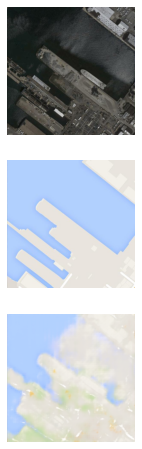

Epoch: 27
Step: 500/1101


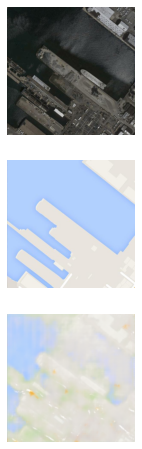

Epoch: 27
Step: 600/1101


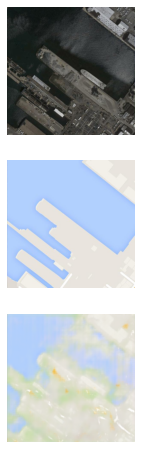

Epoch: 27
Step: 700/1101


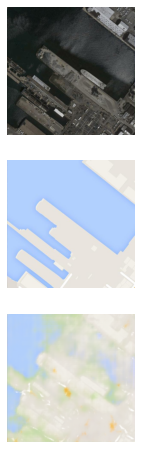

Epoch: 27
Step: 800/1101


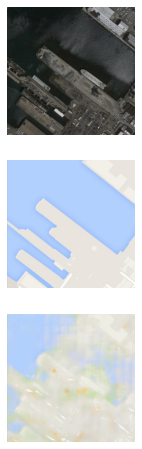

Epoch: 27
Step: 900/1101


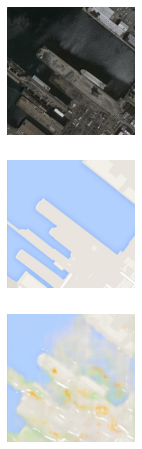

Epoch: 27
Step: 1000/1101


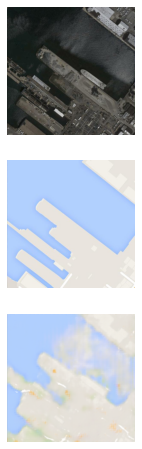

Epoch: 27
Step: 1100/1101


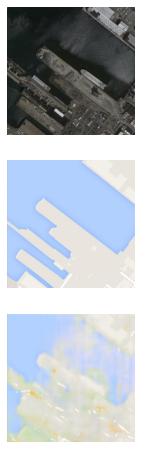

  0%|          | 0/1101 [00:00<?, ?it/s]

Epoch: 28
Step: 100/1101


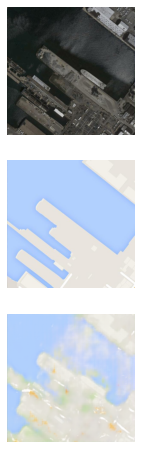

Epoch: 28
Step: 200/1101


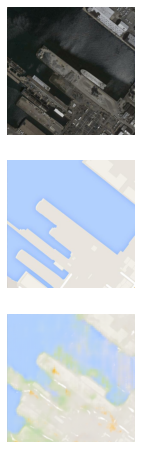

Epoch: 28
Step: 300/1101


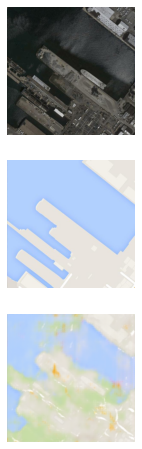

Epoch: 28
Step: 400/1101


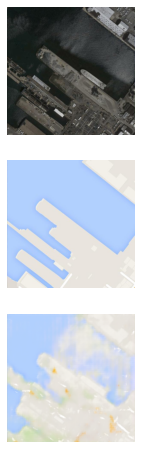

Epoch: 28
Step: 500/1101


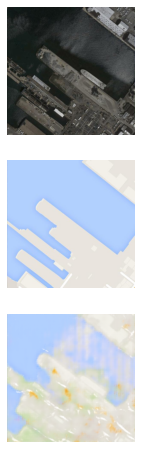

Epoch: 28
Step: 600/1101


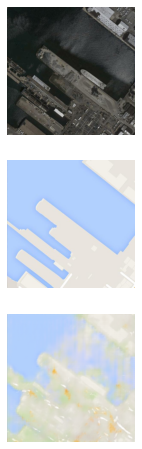

Epoch: 28
Step: 700/1101


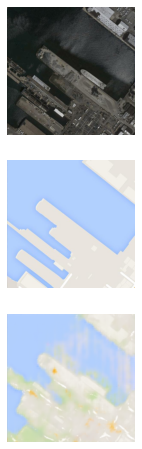

Epoch: 28
Step: 800/1101


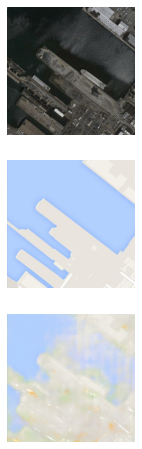

Epoch: 28
Step: 900/1101


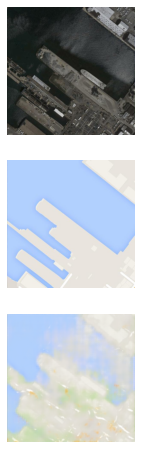

Epoch: 28
Step: 1000/1101


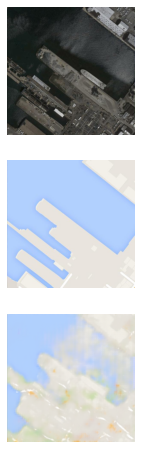

Epoch: 28
Step: 1100/1101


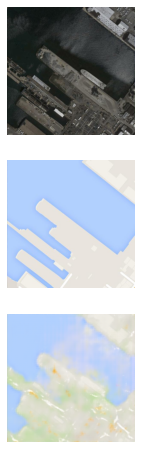

  0%|          | 0/1101 [00:00<?, ?it/s]

Epoch: 29
Step: 100/1101


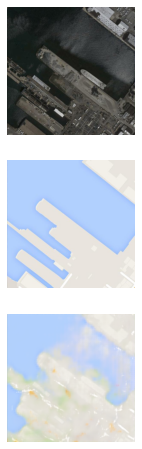

Epoch: 29
Step: 200/1101


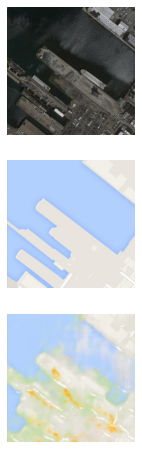

Epoch: 29
Step: 300/1101


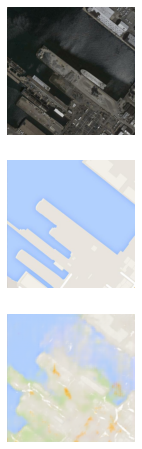

Epoch: 29
Step: 400/1101


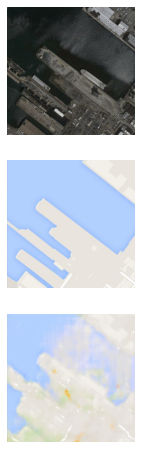

Epoch: 29
Step: 500/1101


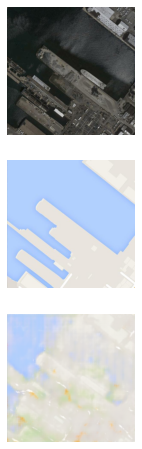

Epoch: 29
Step: 600/1101


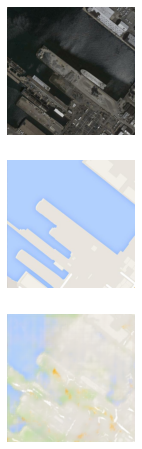

Epoch: 29
Step: 700/1101


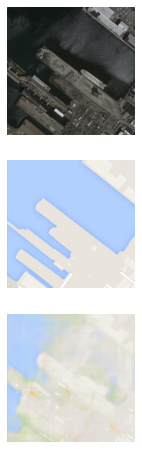

Epoch: 29
Step: 800/1101


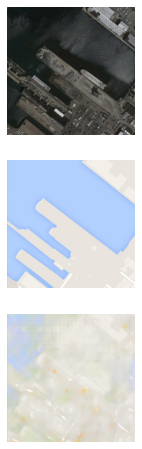

Epoch: 29
Step: 900/1101


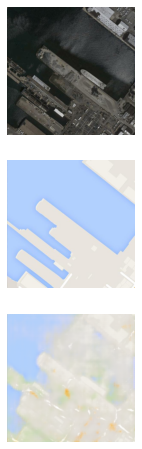

Epoch: 29
Step: 1000/1101


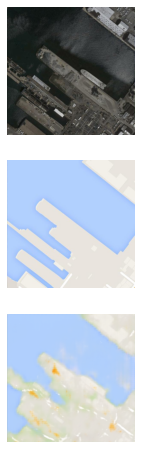

Epoch: 29
Step: 1100/1101


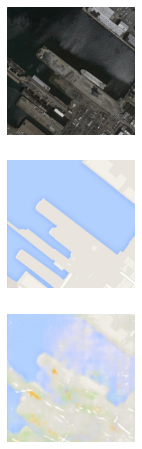

  0%|          | 0/1101 [00:00<?, ?it/s]

Epoch: 30
Step: 100/1101


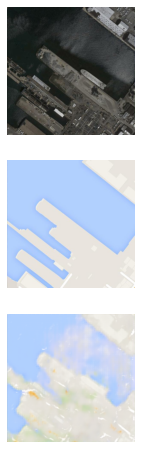

Epoch: 30
Step: 200/1101


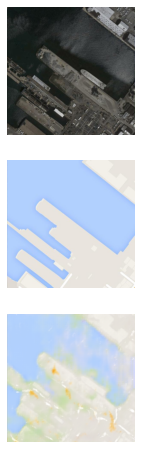

Epoch: 30
Step: 300/1101


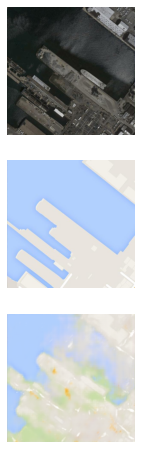

Epoch: 30
Step: 400/1101


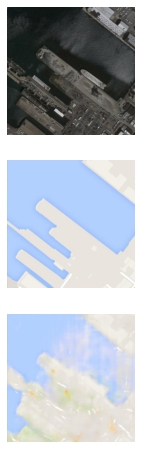

Epoch: 30
Step: 500/1101


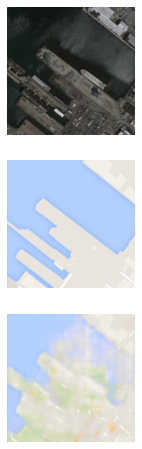

Epoch: 30
Step: 600/1101


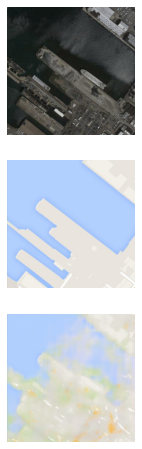

Epoch: 30
Step: 700/1101


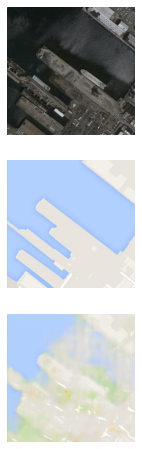

Epoch: 30
Step: 800/1101


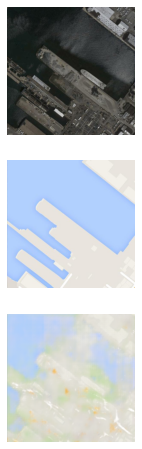

Epoch: 30
Step: 900/1101


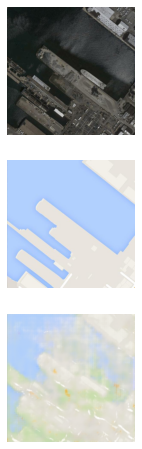

Epoch: 30
Step: 1000/1101


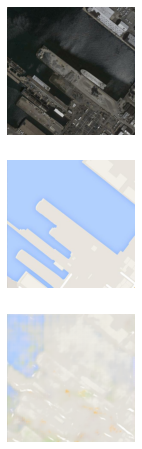

Epoch: 30
Step: 1100/1101


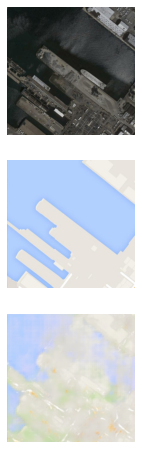

  0%|          | 0/1101 [00:00<?, ?it/s]

Epoch: 31
Step: 100/1101


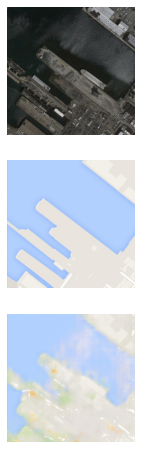

Epoch: 31
Step: 200/1101


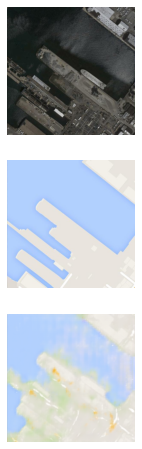

Epoch: 31
Step: 300/1101


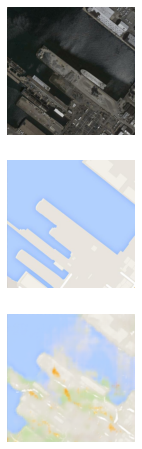

In [ ]:
epochs = 100

visual = next(iter(val_dl))
for e in range(epochs):
    counter = 0
    for data in tqdm(train_dl):
        model.setup_input(data)
        model.optimize()
        counter += 1
        if counter % 100 == 0:
            print(f"Epoch: {e + 1}")
            print(f"Step: {counter}/{len(train_dl)}")
            model.generator.eval()
            with torch.no_grad():
                model.setup_input(visual)
                model.forward()
            model.generator.train()
            generated_tar = (model.generated_tar.detach() + 1) / 2.0
            real_tar = (model.tar + 1) / 2.0
            src = (model.src + 1) / 2.0
            fig = plt.figure(figsize=(15, 8))
            ax = plt.subplot(3, 1, 1)
            ax.imshow(torch.permute(src.cpu().squeeze(), (1, 2, 0)))
            ax.axis("off")
            ax = plt.subplot(3, 1, 2)
            ax.imshow(torch.permute(real_tar.cpu().squeeze(), (1, 2, 0)))
            ax.axis("off")
            ax = plt.subplot(3, 1, 3)
            ax.imshow(torch.permute(generated_tar.cpu().squeeze(), (1, 2, 0)))
            ax.axis("off")
            plt.show()